In [1]:
# import necessary libraries
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import normalize
from scipy.sparse.linalg import eigsh
from scipy.signal import find_peaks
from scipy.spatial import Delaunay
from scipy.spatial import distance
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import multiprocessing as mp
from sklearn import metrics
import networkx as nx
import numpy as np
import random
import csv

In [2]:
def plot_points(P, labels, plot_tile, s) :
    plt.figure(figsize = (7, 7))
    plt.scatter(P[:,0], P[:,1], c = labels, cmap = 'rainbow_r', s = s)
    plt.gca().set_aspect('equal'), plt.title(plot_tile), plt.xlabel('x(mm)'), plt.ylabel('y(mm)')
    plt.show()

In [3]:
def plot_the_graph(G, P, plot_title, node_size):
    plt.figure(figsize=(7,7))
    edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())
    nx.draw(G, P, node_size=[node_size for v in range(P.shape[0])], node_color='lightgreen'
            ,edgelist=edges, edge_color=weights, width=5, edge_cmap=plt.cm.Blues)
    plt.title(plot_title)
    plt.gca().set_aspect('equal')
    plt.show()

In [4]:
def plot_clusters_with_graph(G, P, labels, plot_title, node_size):
    plt.figure(figsize=(7, 7))
    edges, weights = zip(*nx.get_edge_attributes(G,'weight').items())
    nodes = [i for i in G.nodes()]
    e = []
    w = []

    for i, edge in enumerate(edges):
        p1 = edge[0]
        p2 = edge[1]
        if labels[p1] == labels[p2] :
            e.append((p1, p2))
            w.append(1000)

    nx.draw(G, P, node_size=[node_size for v in range(P.shape[0])], node_color=labels[nodes], 
            cmap=plt.cm.rainbow_r ,edgelist=e, edge_color=w, width=1)
    plt.title(plot_title)
    plt.show()

In [5]:
def denoise(P, Sigma, sigma_s, noise_thrsh, plot_den_hist) :
    # Inputs : 
    # P_i           : [x, y], the localization centers
    # Sigma_i       : [[sigma_x_i, 0], [0, sigma_y_i]] where sigma_x_i and sigma_y_i are 
    # uncertinties in x and y direction  of the P_i localization respectively.
    # sigma_s       : scaling parameter
    # noise_thrsh   : threshold used for denoising
    # plot_den_hist : 0 or 1, 1 for when you want the density histogram plot
    
    n_points = P.shape[0]               # number of points
    sg2      = sigma_s ** 2 
    
    # ------- Constructing weighted graph -------
    dt = Delaunay(points=P)             # Delaunay triangulation for input points
    G  = nx.Graph()                     # G will be the weighted graph for the data
    
    for i in range(n_points):
        G.add_node(i)
    
    for path in dt.simplices:
        a  = path[0]
        b  = path[1]
        c  = path[2]
        d1 = np.exp(-(distance.euclidean(P[a], P[b])**2 + np.trace(Sigma[a] + Sigma[b]))/(2*sg2))
        d2 = np.exp(-(distance.euclidean(P[a], P[c])**2 + np.trace(Sigma[a] + Sigma[c]))/(2*sg2))
        d3 = np.exp(-(distance.euclidean(P[b], P[c])**2 + np.trace(Sigma[b] + Sigma[c]))/(2*sg2))
        G.add_weighted_edges_from([(a, b, d1)])
        G.add_weighted_edges_from([(a, c, d2)])
        G.add_weighted_edges_from([(b, c, d3)])
    
    # ------- Denosing -------
    degrees          = G.degree(weight=None)
    n_neighbors      = np.array([i for (_,i) in degrees]).ravel()
    weights          = G.degree(weight='weight')
    weighted_degrees = np.array([i for (_,i) in weights]).ravel()
    density          = np.nan_to_num(weighted_degrees/n_neighbors)

    not_noise_points = np.where(density>noise_thrsh)[0]
    noise_points     = np.where(density<=noise_thrsh)[0]
    
    # ------- Denoising with kmeans - not in the paper -------
#     den_kmeans = KMeans(n_clusters=3, random_state=0, n_init = 20).fit(density.reshape(-1, 1))
#     den_groups       = den_kmeans.labels_
#     den_groups_means = np.array([np.mean(density[np.where(den_groups==i)]) for i in range(3)])
#     min_density      = np.where(den_groups==min(den_groups))[0]
#     not_noise_points = np.where(den_groups!=min_density)[0]
#     noise_points     = np.where(den_groups==min_density)[0]
    
    if plot_den_hist:
        plt.hist(density, bins=100)
        plt.title('histogram of node density -all-')
        plt.show()
        
    return density, noise_points, not_noise_points


In [6]:
# labels : set at domain decomposition step

def cluster_single_scale(P, Sigma, not_noise_point, sigma_s, plot_eigen) :
    # Inputs : 
    # P_i : [x, y], the localization centers
    # Sigma_i : [[sigma_x_i, 0], [0, sigma_y_i]] where sigma_x_i and sigma_y_i are 
    # uncertinties in x and y direction  of the P_i localization respectively.
    # sigma_s : scaling parameter
    # not_noise_point : index of not noise points
    # plot_eigen : 0 or 1, 1 if you want eigenvalues and eigenvalue differences plot

    n_points_wn = P.shape[0]
    P           = P[not_noise_point]
    Sigma       = Sigma[not_noise_point]
    n_points    = P.shape[0]               # number of non-noise points
    sg2         = sigma_s ** 2 
    
    if n_points < 3 :
        print('Not enough points!')
        return
    
    # ------- Constructing weighted graph -------
    dt = Delaunay(points=P)             # Delaunay triangulation for input points
    G  = nx.Graph()                     # G will be the weighted graph for the data
    
    for i in range(n_points):
        G.add_node(i)
    
    for path in dt.simplices:
        a  = path[0]
        b  = path[1]
        c  = path[2]
        d1 = np.exp(-(distance.euclidean(P[a], P[b])**2 + np.trace(Sigma[a] + Sigma[b]))/(2*sg2))
        d2 = np.exp(-(distance.euclidean(P[a], P[c])**2 + np.trace(Sigma[a] + Sigma[c]))/(2*sg2))
        d3 = np.exp(-(distance.euclidean(P[b], P[c])**2 + np.trace(Sigma[b] + Sigma[c]))/(2*sg2))
        G.add_weighted_edges_from([(a, b, d1)])
        G.add_weighted_edges_from([(a, c, d2)])
        G.add_weighted_edges_from([(b, c, d3)])
        
    # ------- Spectral Clustering -------
    
    # ------- 1. Calculating eigenvalues and eigenvectors -------
    vals, vecs = eigsh(nx.laplacian_matrix(G), k=n_points-1, which='SM')
                    
    # ------- 2. Determining number of clusters -------
    
    diff_vals  = np.diff(vals[0:int(n_points/2)])
    prominence = np.max(diff_vals) / 4
    k          = np.min(np.where(diff_vals >= prominence)[0]) + 1
    
    if vals[1] > prominence:   # handle only 1 cluster case
        k = 1
        
    if plot_eigen:
        fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(12, 4))
        axs[0].scatter(list(range(len(diff_vals[0:k+5]))), diff_vals[0:k+5])
        axs[0].set_title('Eigenvalue Differences')
        axs[1].scatter(list(range(len(vals[0:k+5]))), vals[0:k+5])
        axs[1].set_title('Eigenvalues')
        plt.show()
        
    # ------- 3. Kmeans -------
    kmeans_spec = KMeans(n_clusters=k, random_state=0, n_init = 20).fit(vecs[:,0:k])
    labels_not_noise = kmeans_spec.labels_
    
    labels                  = np.zeros((n_points_wn, 1)).ravel() - 1 # -1 is label for noise
    labels[not_noise_point] = labels_not_noise
    
    return labels, G, k

In [7]:
def cluster_to_point(P, Sigma, n, k, labels) :
    # This function turns clusters into their respresentitive point of the next scale
    # Inputs : 
    # P_i : [x, y], the localization centers
    # Sigma_i : [[sigma_x_i, 0], [0, sigma_y_i]] where sigma_x_i and sigma_y_i are 
    # uncertinties in x and y direction  of the P_i localization respectively.
    # n_i : number of photons in P_i th detection
    
    P_next      = np.zeros((k, 2))
    Sigma_next  = np.zeros((k, 2, 2))
    n_next      = np.zeros((k, 1)).ravel()
    cluster_id  = np.zeros((k, 1))

    for i, cluster_num in enumerate(np.unique(labels)):
        idx_cluster = np.where(labels==cluster_num)[0]
        mx          = np.average(P[idx_cluster, 0], axis=0, weights=n[idx_cluster])
        my          = np.average(P[idx_cluster, 1], axis=0, weights=n[idx_cluster])
        sx          = 0
        sy          = 0
        sxy         = 0
        
        for idx in idx_cluster : 
            sx  = (P[idx,0]-mx) ** 2 * n[idx] + sx
            sy  = (P[idx,1]-my) ** 2 * n[idx] + sy
            sxy = (P[idx,0]-mx) * (P[idx,1]-my) * n[idx] + sxy
            
        sx  = sx  / (np.sum(n[idx_cluster]))
        sy  = sy  / (np.sum(n[idx_cluster]))
        sxy = sxy / (np.sum(n[idx_cluster]))
        
        P_next[i]      = [mx, my]
        Sigma_next[i]  = [[sx, sxy], [sxy, sy]]
        n_next[i]      = np.sum(n[idx_cluster])
        cluster_id[i]  = cluster_num 
        
    return P_next, Sigma_next, n_next, cluster_id

In [8]:
def map_label_to_input(labels1_fid, labels2, k2, cluster_id2):
    # This function maps clustering labels of a specific scale data to the input data
    # Inputs:
    # labels1_fid : labels of the previous scale for the input data
    # labels2 : labels of data clustered at the current scale
    # k2 : number of the clusters in the current scale

    labels2_fid     = labels1_fid.copy()
    counter         = k2
    
    for lbl in np.unique(labels2):
        idx_ns = cluster_id2[np.where(labels2==lbl)[0]]

        if lbl == -1:
            for idx in idx_ns:
                idx_fs              = np.where(labels1_fid==idx)[0]
                labels2_fid[idx_fs] = counter
                counter = counter + 1

        else:
            for idx in idx_ns:
                idx_fs              = np.where(labels1_fid==idx)[0]
                labels2_fid[idx_fs] = lbl
            
    return labels2_fid, counter

In [9]:
# decompose_k will be set to 0
# G_labels : zeros allocation of length of n_points -> labels of the domain for each point
# G_Data : input data to decompose

def domain_decompose(idx, borders, thrsh):
    # idx     : index of points in the current domain
    # borders : (min_x, max_x, min_y, max_y) of the domain sqaure
    # thrsh   : maximum number of points in a domain to not be decomposed  
    global G_Data, decompose_k, G_labels
    
    (min_x, max_x, min_y, max_y) = borders
    midx                         = (max_x + min_x) / 2
    midy                         = (max_y + min_y) / 2
    Data_level                   = G_Data[idx]
    n                            = Data_level.shape[0]

    if n < thrsh:
        G_labels[idx] = decompose_k
        decompose_k   = decompose_k + 1
        return
    
    plx = np.where(Data_level[:,0] <  midx)
    pux = np.where(Data_level[:,0] >= midx)
    ply = np.where(Data_level[:,1] <  midy)
    puy = np.where(Data_level[:,1] >= midy)
    
    for part in range(1,5):
        if part == 1:
            pidx = idx[np.intersect1d(plx,ply)]
            np1  = len(pidx)
            if np1 > thrsh : 
                domain_decompose(pidx, (min_x, midx, min_y, midy), thrsh)
            else : 
                G_labels[pidx] = decompose_k
                decompose_k    = decompose_k + 1
                
        if part == 2:
            pidx = idx[np.intersect1d(pux,ply)]
            np2  = len(pidx)
            if np2 > thrsh : 
                domain_decompose(pidx, (midx, max_x, min_y, midy), thrsh)
            else : 
                G_labels[pidx] = decompose_k
                decompose_k    = decompose_k + 1
                
        if part == 3:
            pidx = idx[np.intersect1d(pux,puy)]
            np3  = len(pidx)
            if np3 > thrsh : 
                domain_decompose(pidx, (midx, max_x, midy, max_y), thrsh)
            else : 
                G_labels[pidx] = decompose_k
                decompose_k    = decompose_k + 1
                
        if part == 4:
            pidx = idx[np.intersect1d(plx,puy)]
            np4  = len(pidx)
            if np4 > thrsh : 
                domain_decompose(pidx, (min_x, midx, midy, max_y), thrsh)
            else : 
                G_labels[pidx] = decompose_k
                decompose_k    = decompose_k + 1
                
                

In [10]:
# read or generate data
# this data is the 2scale real example -paxillin- in the papaer

P1 = np.array([[0, 0]])    # Allocate data, Point Clouds(x,y) will be stored in data

# Read data:
with open('paxilin.csv', newline='') as test:
    Rows = csv.reader(test, delimiter=' ', quotechar='|')
    # split each row and extract (x, y)
    for i, row in enumerate(Rows):
        if i % 10000 == 0 : 
            print(i)
        row_array_str=row[0].split(',')
        row_array_float=[]
        row_array_float.append(float(row_array_str[0]))
        row_array_float.append(float(row_array_str[1]))
        P1 = np.append(P1, [row_array_float], axis = 0)
        
Sigma1 = np.zeros((P1.shape[0], 2, 2)) 
n1     = np.ones((P1.shape[0], 1)).ravel()

print('Data Read!')

0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000
210000
220000
230000
240000
250000
260000
270000
Data Read!


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: RuntimeWarning: invalid value encountered in true_divide


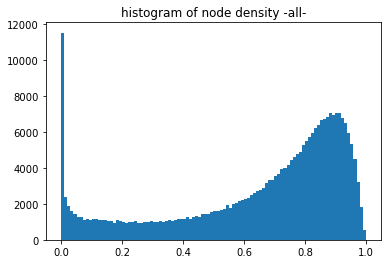

In [11]:
# denoise the data
density1, noise_points1, not_noise_points1 = denoise(P1, Sigma1, 30, 0.34, 1)
P1     = P1[not_noise_points1]
Sigma1 = Sigma1[not_noise_points1]
n1     = n1[not_noise_points1]

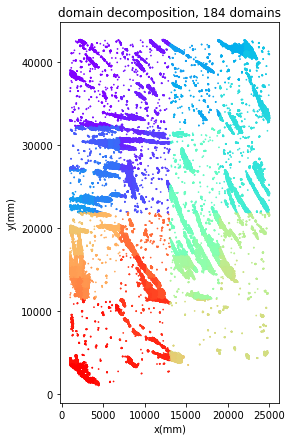

In [12]:
# domain decomposition
G_Data      = P1
G_labels    = np.zeros((P1.shape[0] , 1))
decompose_k = 0
domian_trsh = 3500
(min_x, max_x , min_y,max_y) = (np.min(G_Data[:,0]), np.max(G_Data[:,0]), np.min(G_Data[:,1]), np.max(G_Data[:,1]))
borders     = (min_x, max_x, min_y, max_y)
domain_decompose(np.array(list(range(G_Data.shape[0]))), borders, domian_trsh)
n_domains   = decompose_k
plot_points(P1, G_labels, 'domain decomposition, ' + str(n_domains) + ' domains', 0.5)

---------------- domain number 0 ----------------


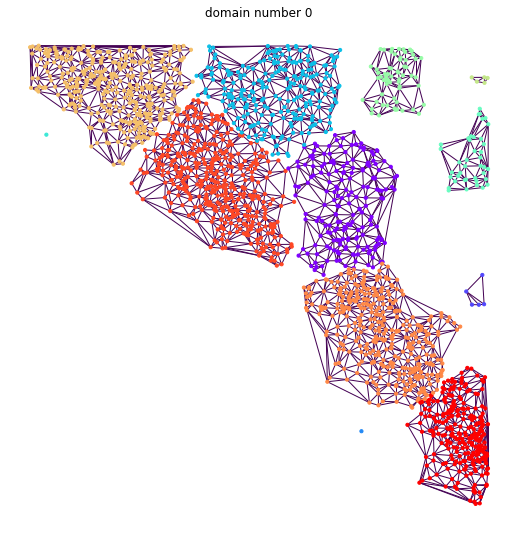

-----------------------------------------------
---------------- domain number 1 ----------------


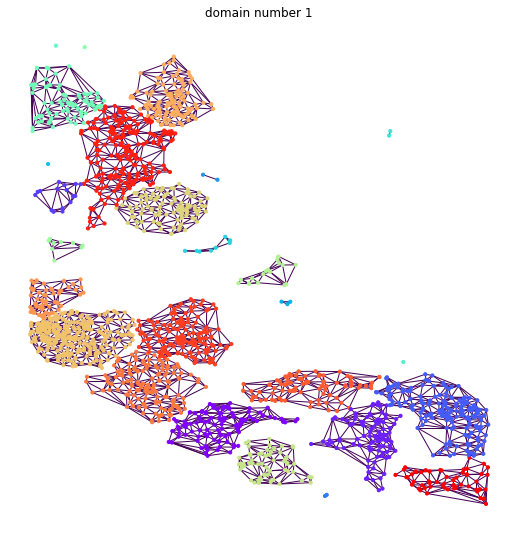

-----------------------------------------------
---------------- domain number 2 ----------------


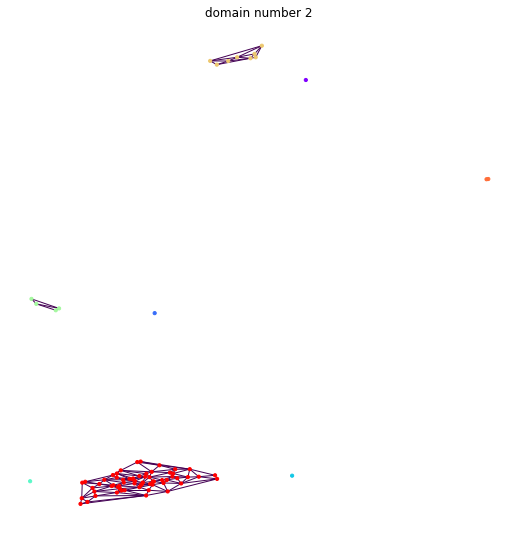

-----------------------------------------------
---------------- domain number 3 ----------------


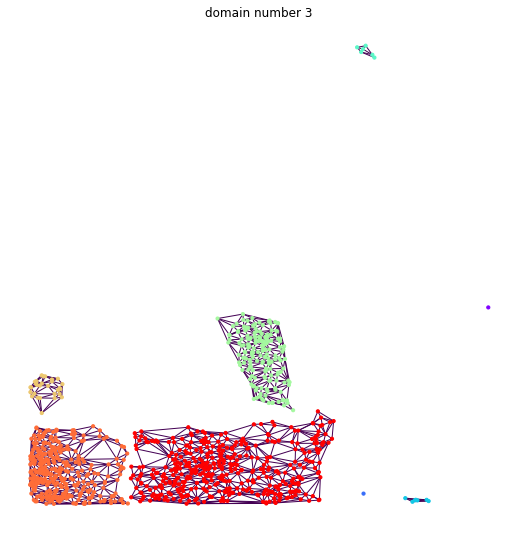

-----------------------------------------------
---------------- domain number 4 ----------------


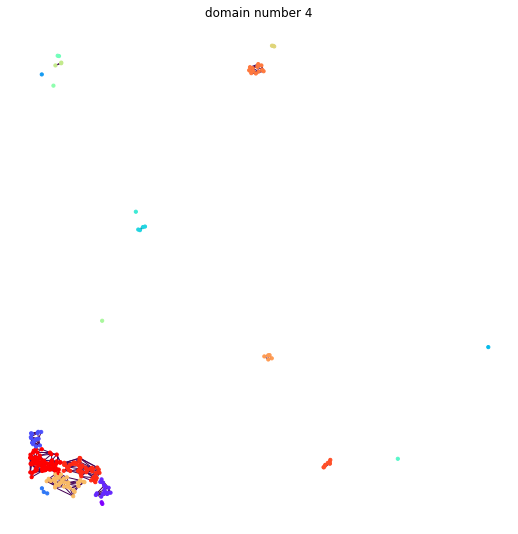

-----------------------------------------------
---------------- domain number 5 ----------------


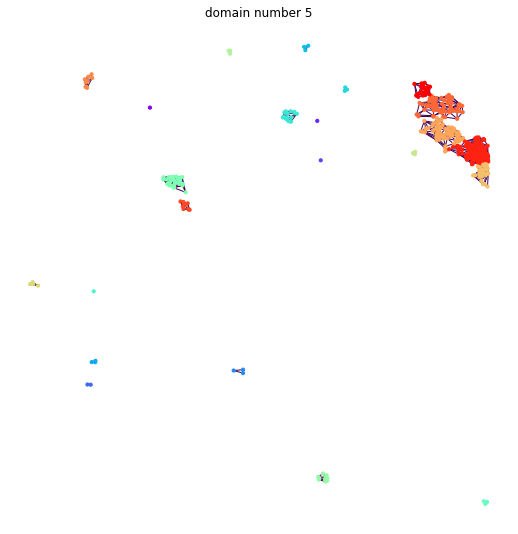

-----------------------------------------------
---------------- domain number 6 ----------------


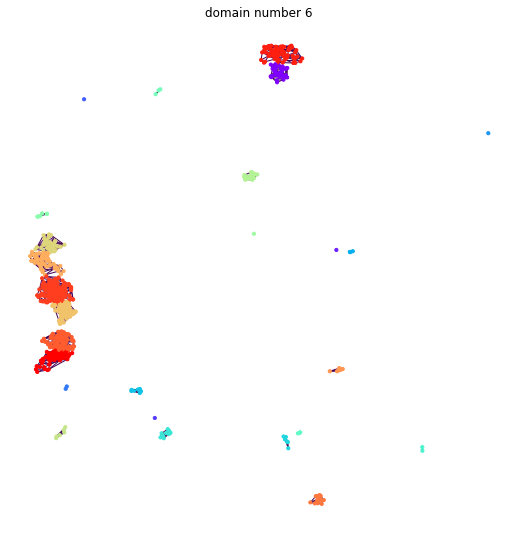

-----------------------------------------------
---------------- domain number 7 ----------------


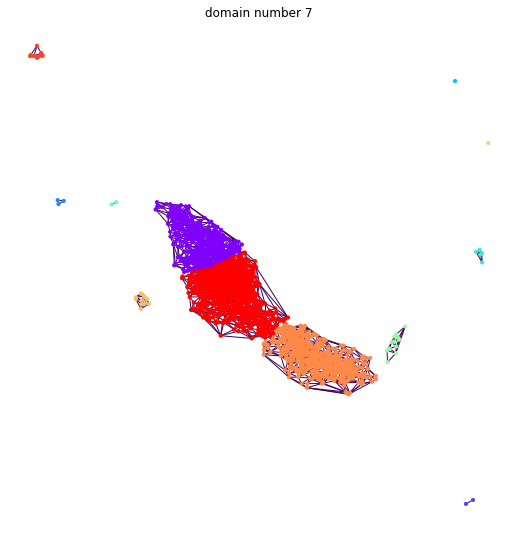

-----------------------------------------------
---------------- domain number 8 ----------------


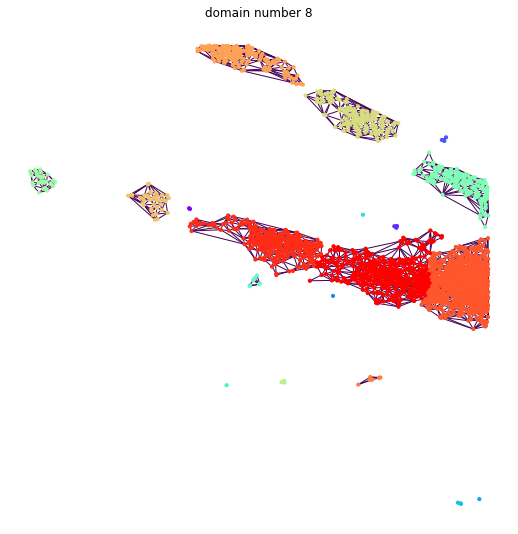

-----------------------------------------------
---------------- domain number 9 ----------------


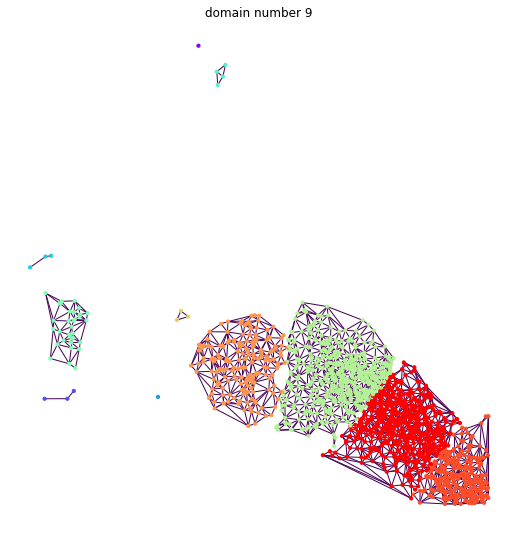

-----------------------------------------------
---------------- domain number 10 ----------------


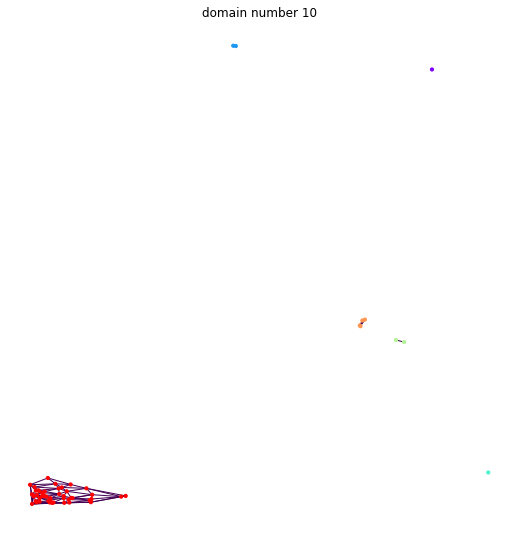

-----------------------------------------------
---------------- domain number 11 ----------------


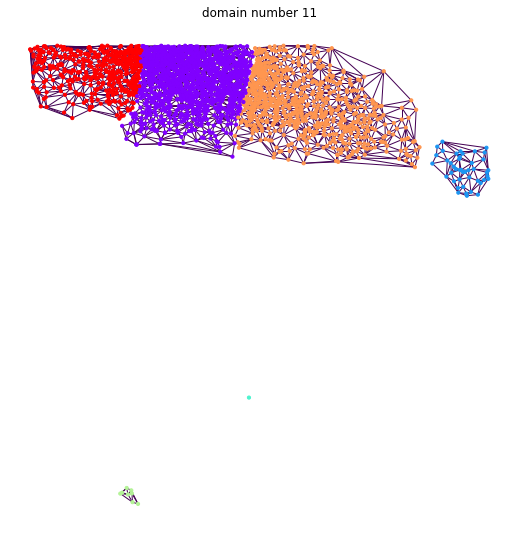

-----------------------------------------------
---------------- domain number 12 ----------------


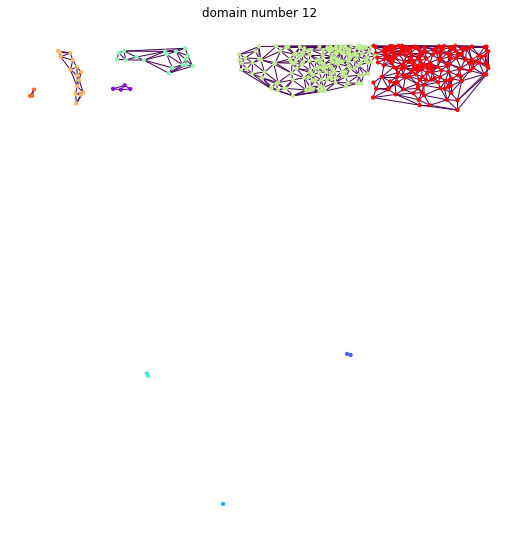

-----------------------------------------------
---------------- domain number 13 ----------------


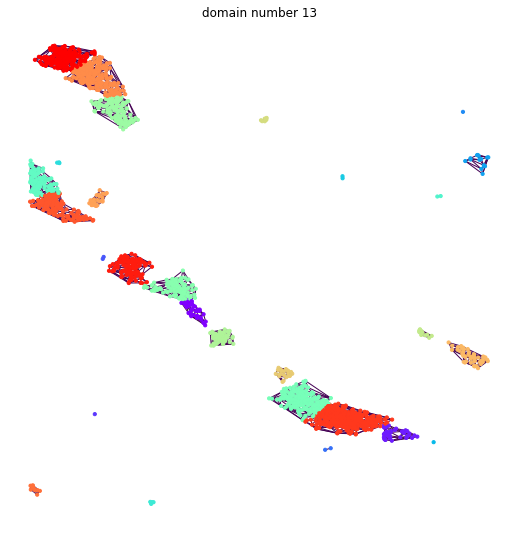

-----------------------------------------------
---------------- domain number 14 ----------------


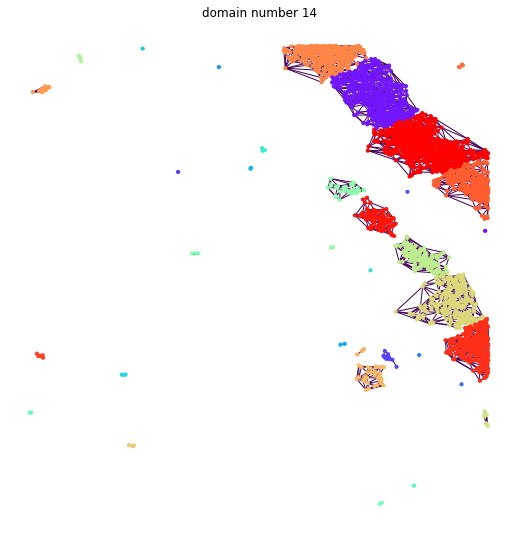

-----------------------------------------------
---------------- domain number 15 ----------------


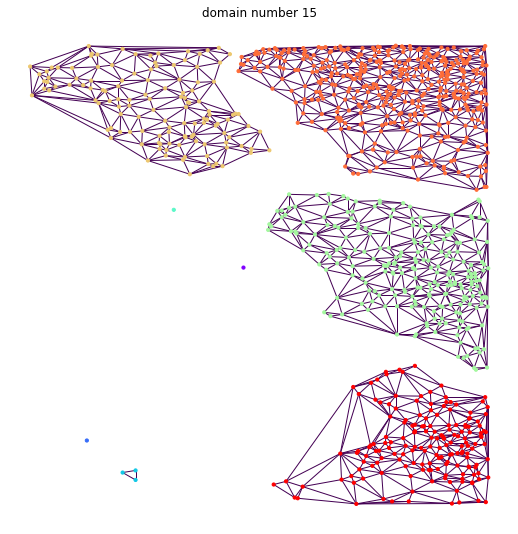

-----------------------------------------------
---------------- domain number 16 ----------------


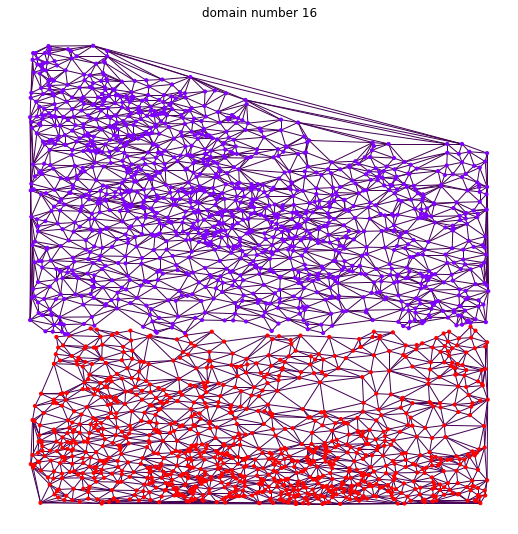

-----------------------------------------------
---------------- domain number 17 ----------------


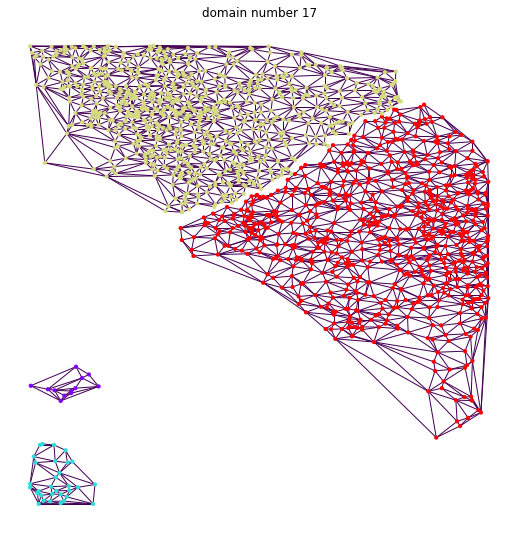

-----------------------------------------------
---------------- domain number 18 ----------------


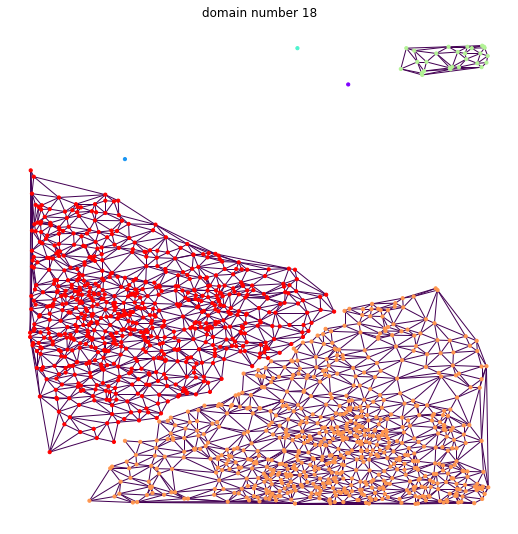

-----------------------------------------------
---------------- domain number 19 ----------------


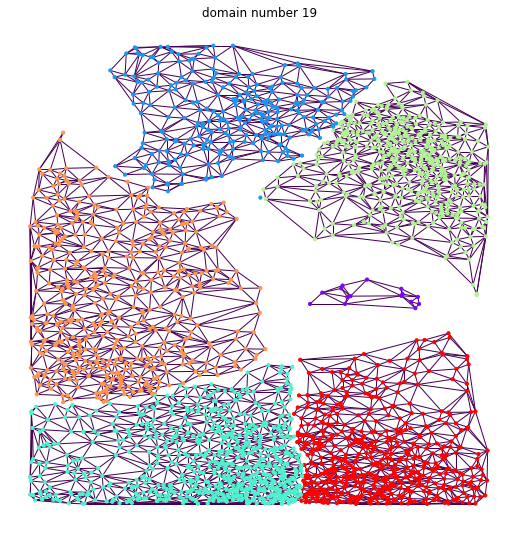

-----------------------------------------------
---------------- domain number 20 ----------------


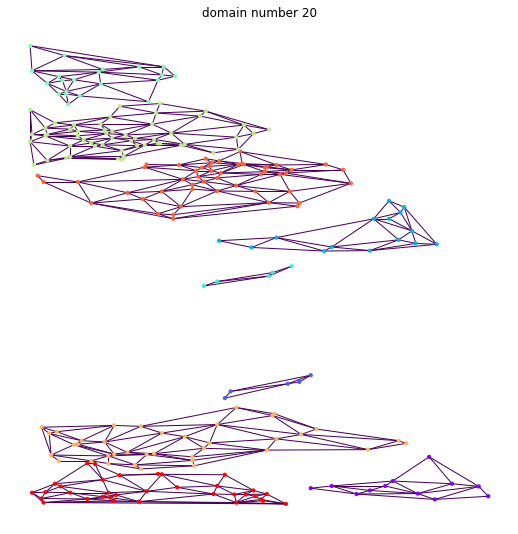

-----------------------------------------------
---------------- domain number 21 ----------------
-----------------------------------------------
---------------- domain number 22 ----------------


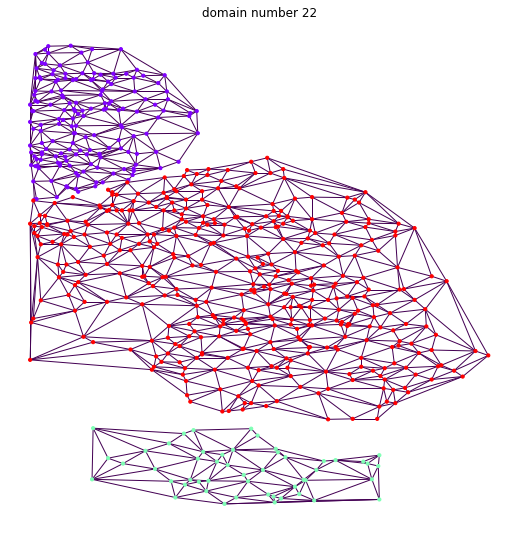

-----------------------------------------------
---------------- domain number 23 ----------------


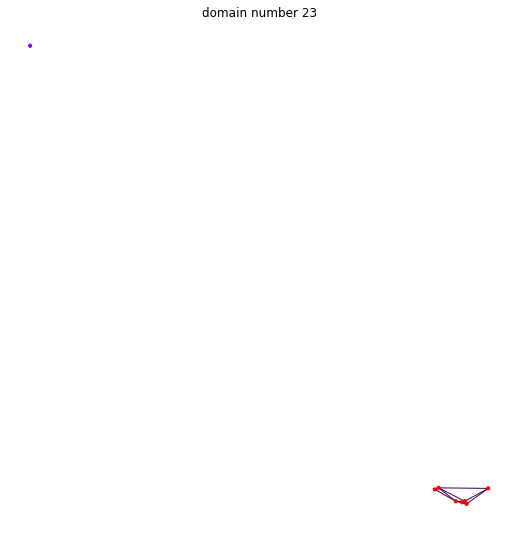

-----------------------------------------------
---------------- domain number 24 ----------------


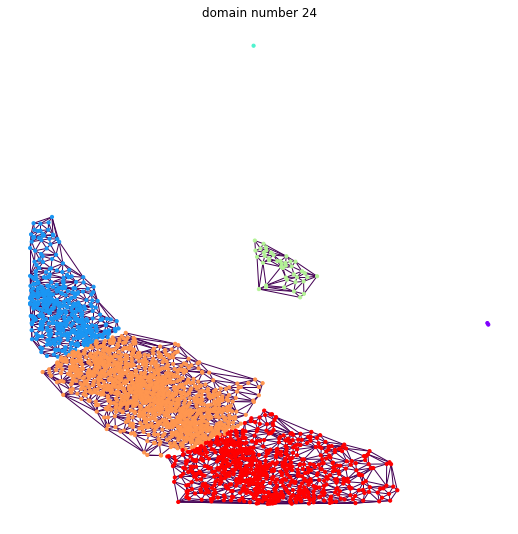

-----------------------------------------------
---------------- domain number 25 ----------------


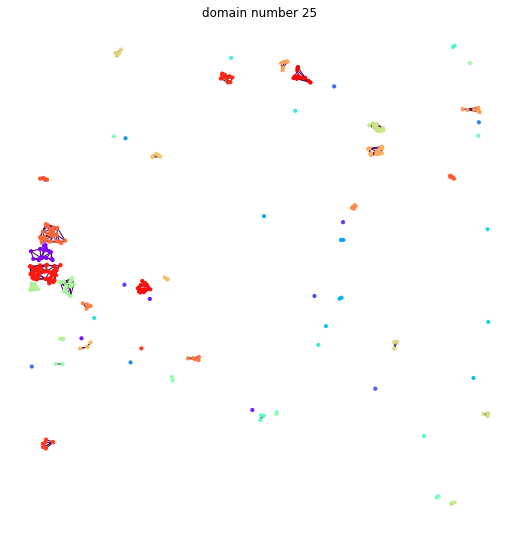

-----------------------------------------------
---------------- domain number 26 ----------------


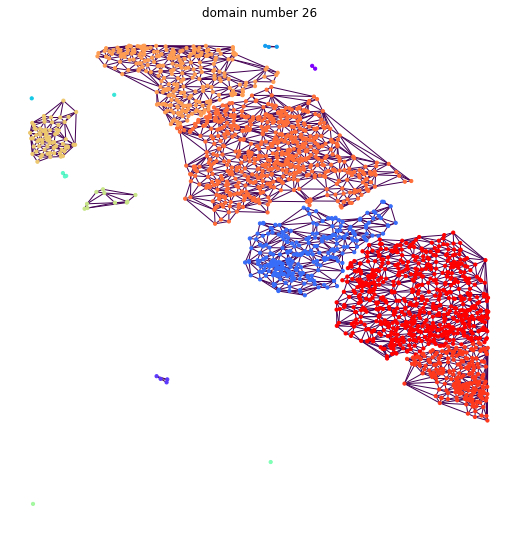

-----------------------------------------------
---------------- domain number 27 ----------------


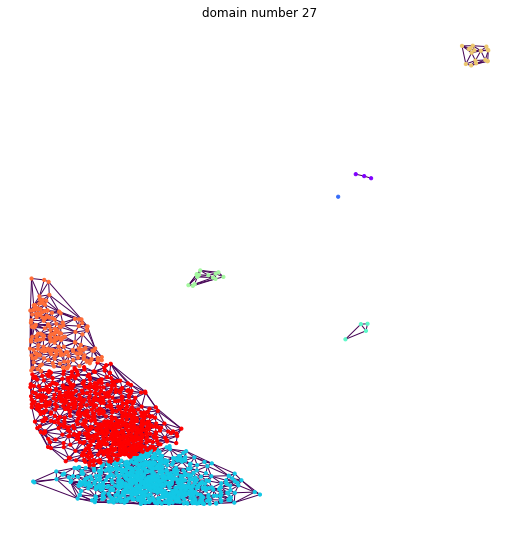

-----------------------------------------------
---------------- domain number 28 ----------------


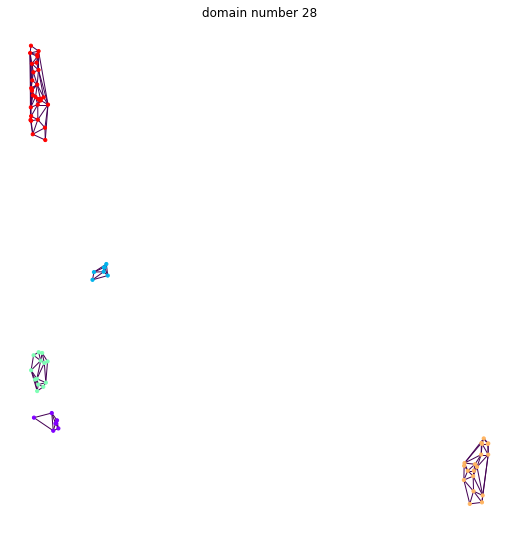

-----------------------------------------------
---------------- domain number 29 ----------------


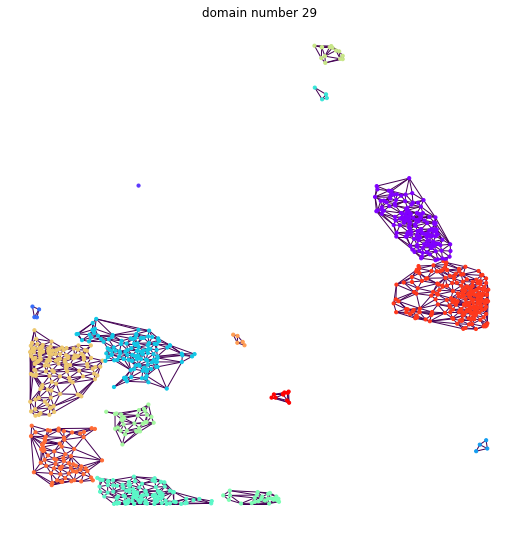

-----------------------------------------------
---------------- domain number 30 ----------------


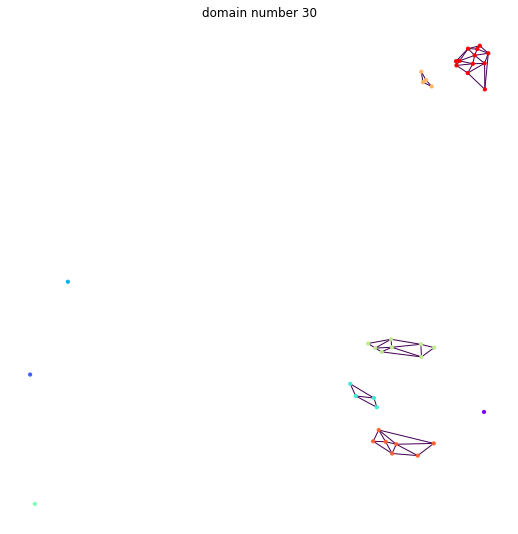

-----------------------------------------------
---------------- domain number 31 ----------------


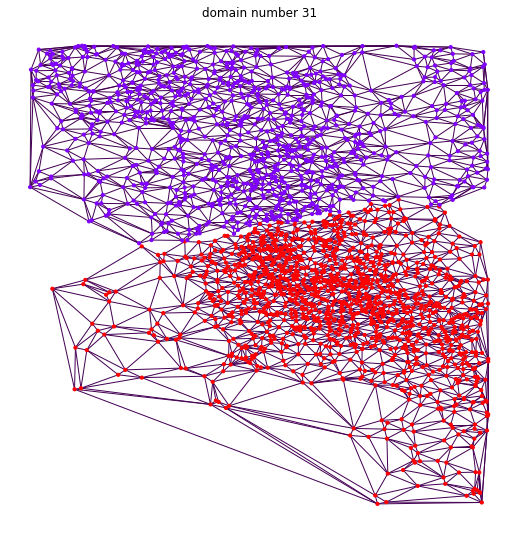

-----------------------------------------------
---------------- domain number 32 ----------------


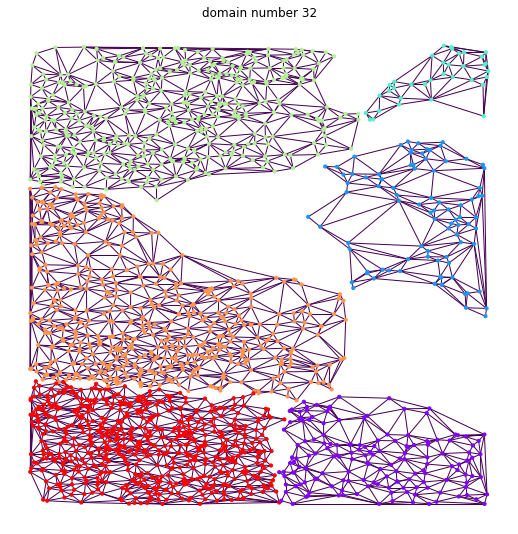

-----------------------------------------------
---------------- domain number 33 ----------------


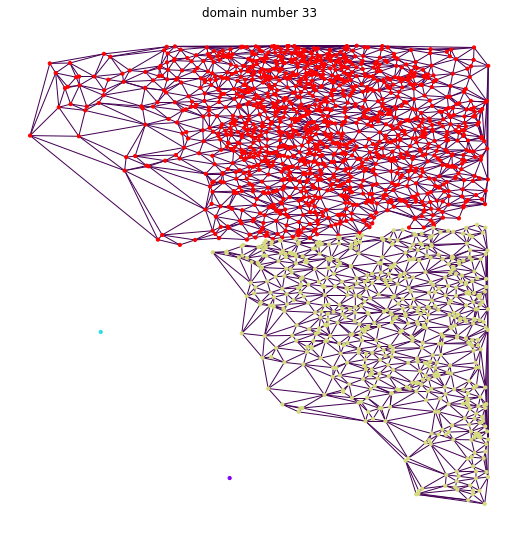

-----------------------------------------------
---------------- domain number 34 ----------------


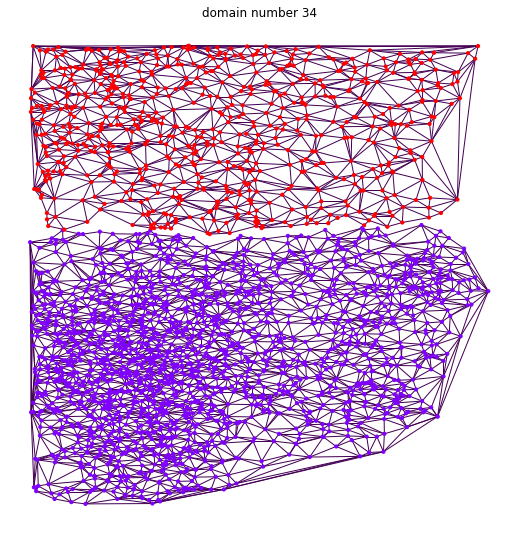

-----------------------------------------------
---------------- domain number 35 ----------------


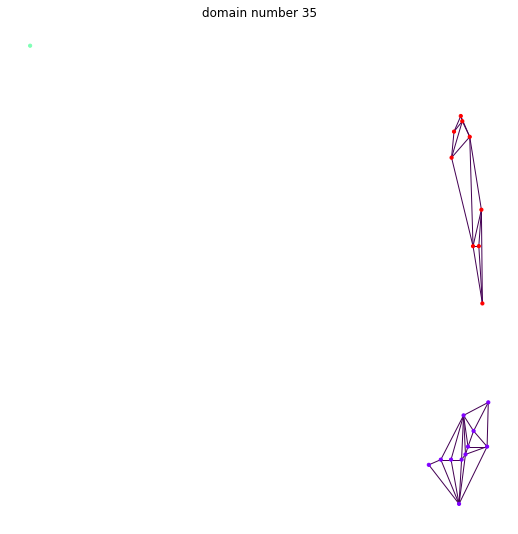

-----------------------------------------------
---------------- domain number 36 ----------------


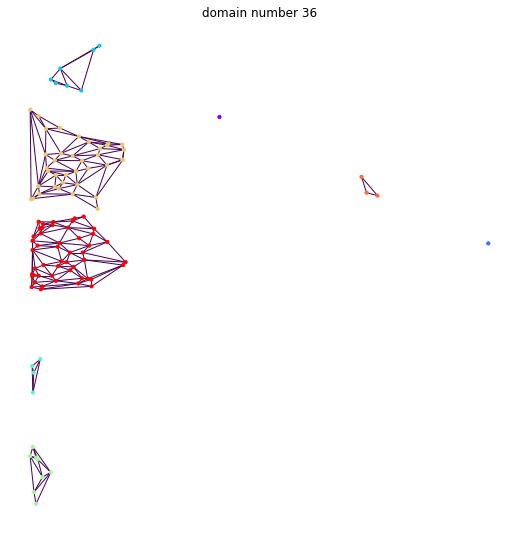

-----------------------------------------------
---------------- domain number 37 ----------------


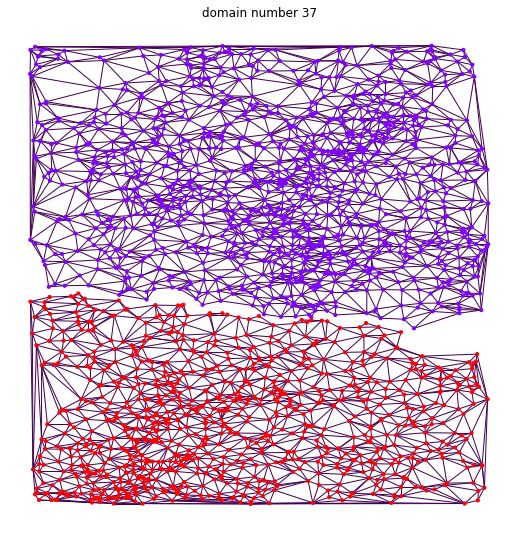

-----------------------------------------------
---------------- domain number 38 ----------------


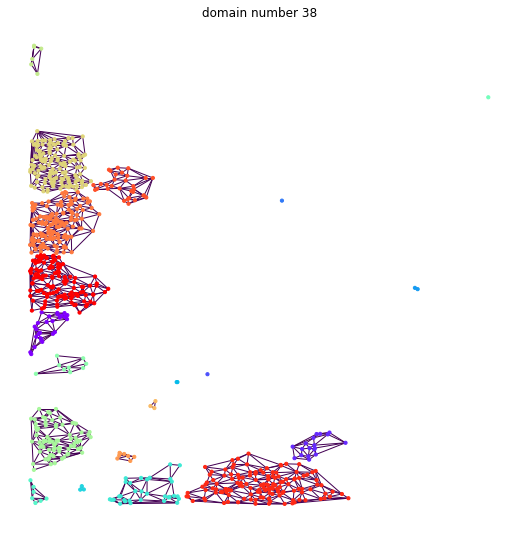

-----------------------------------------------
---------------- domain number 39 ----------------


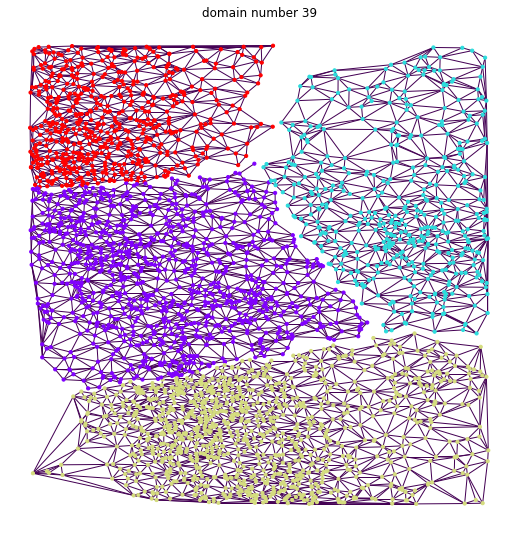

-----------------------------------------------
---------------- domain number 40 ----------------


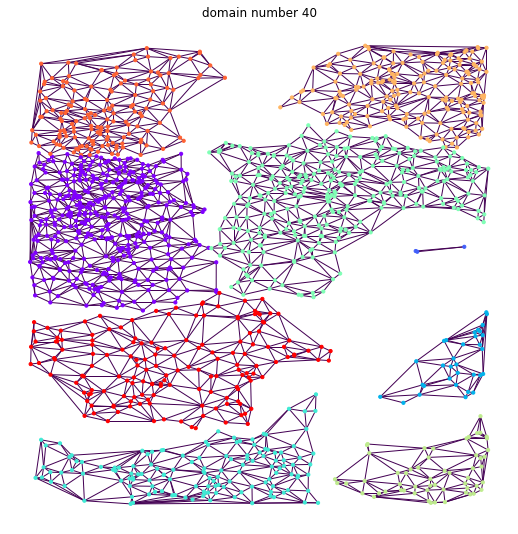

-----------------------------------------------
---------------- domain number 41 ----------------


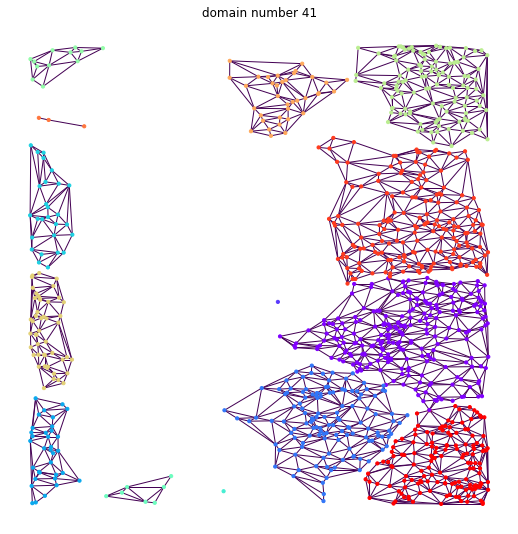

-----------------------------------------------
---------------- domain number 42 ----------------


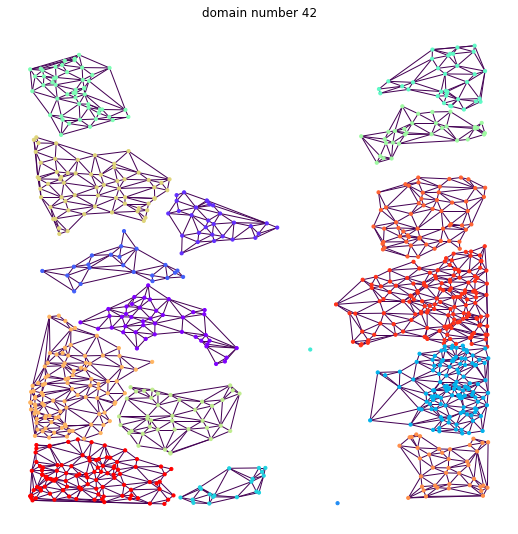

-----------------------------------------------
---------------- domain number 43 ----------------


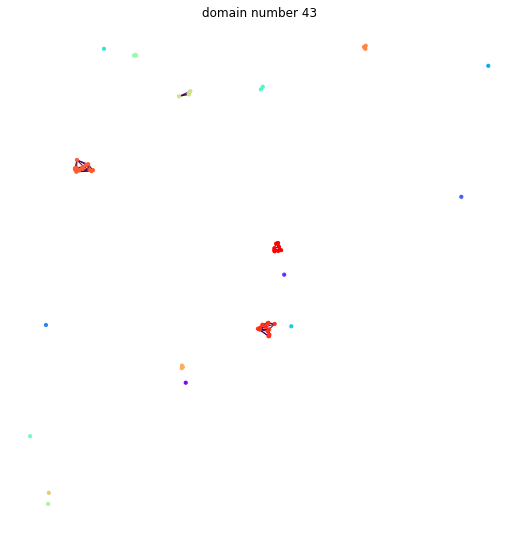

-----------------------------------------------
---------------- domain number 44 ----------------


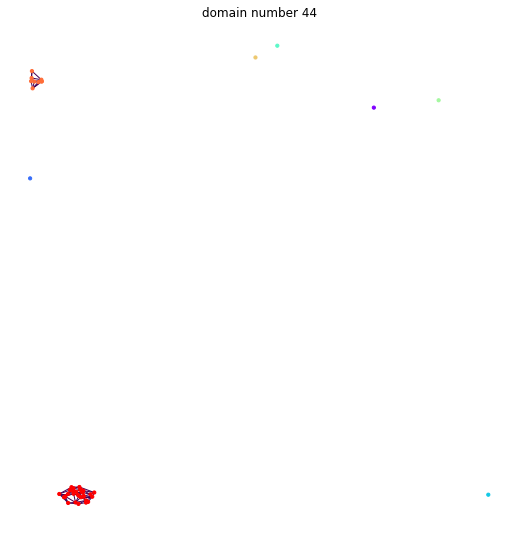

-----------------------------------------------
---------------- domain number 45 ----------------


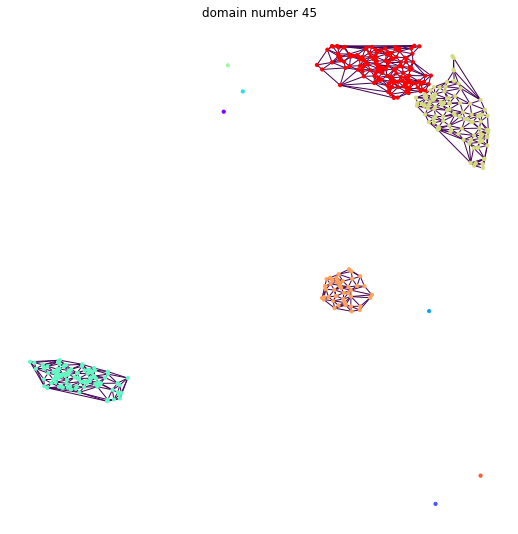

-----------------------------------------------
---------------- domain number 46 ----------------


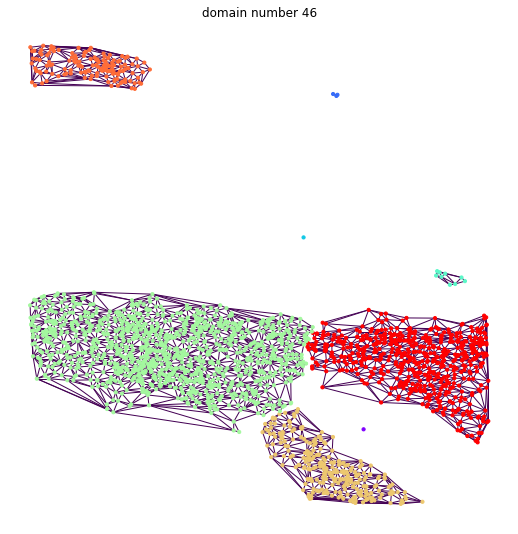

-----------------------------------------------
---------------- domain number 47 ----------------


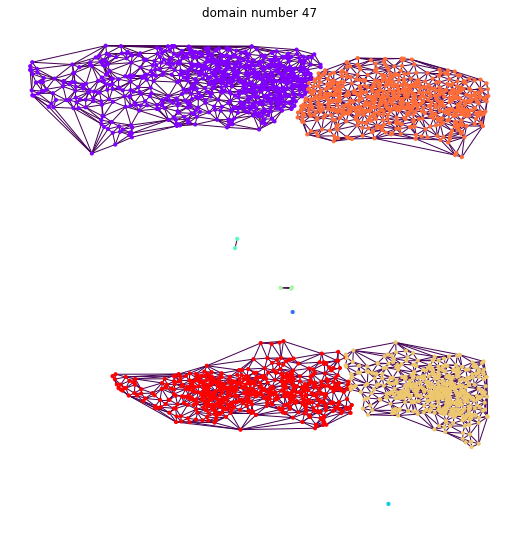

-----------------------------------------------
---------------- domain number 48 ----------------


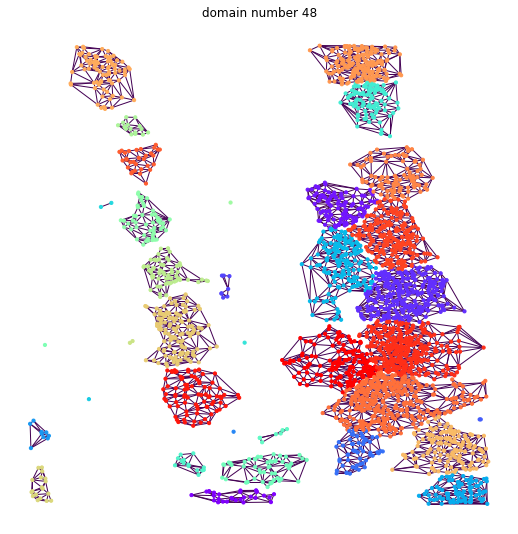

-----------------------------------------------
---------------- domain number 49 ----------------


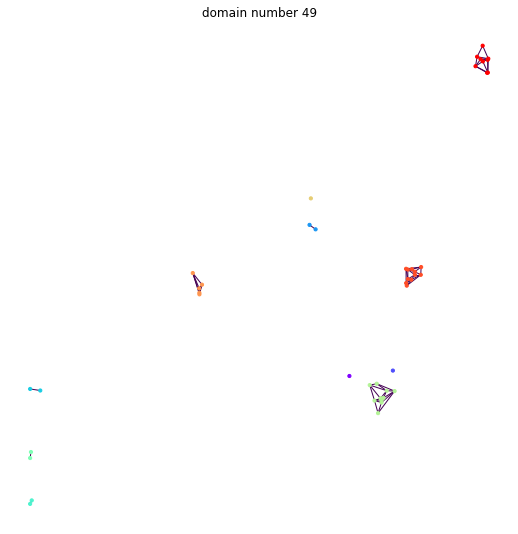

-----------------------------------------------
---------------- domain number 50 ----------------


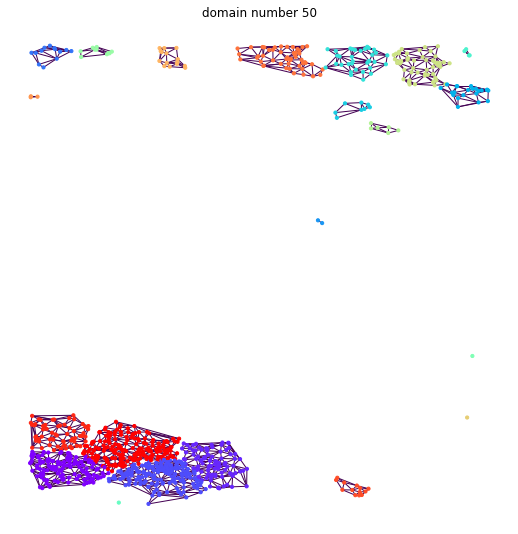

-----------------------------------------------
---------------- domain number 51 ----------------


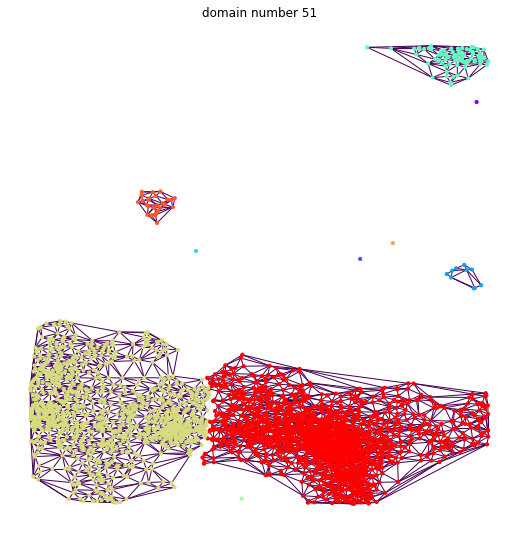

-----------------------------------------------
---------------- domain number 52 ----------------
-----------------------------------------------
---------------- domain number 53 ----------------
-----------------------------------------------
---------------- domain number 54 ----------------


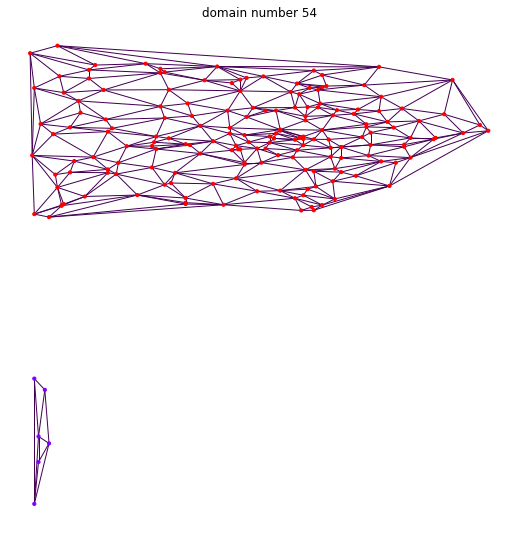

-----------------------------------------------
---------------- domain number 55 ----------------


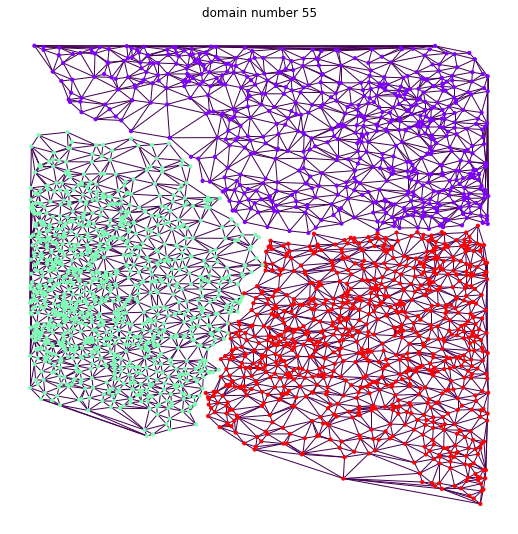

-----------------------------------------------
---------------- domain number 56 ----------------


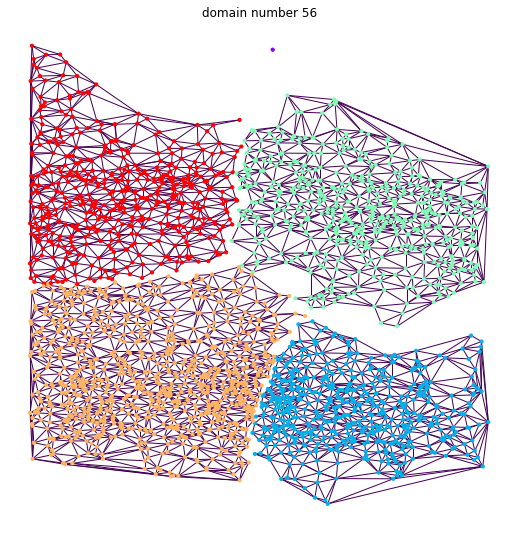

-----------------------------------------------
---------------- domain number 57 ----------------
-----------------------------------------------
---------------- domain number 58 ----------------


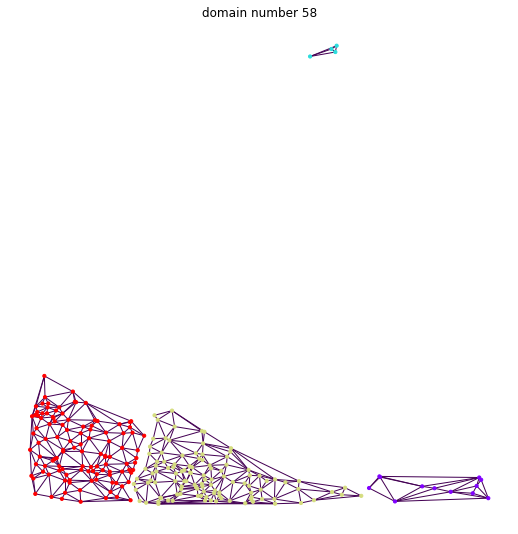

-----------------------------------------------
---------------- domain number 59 ----------------


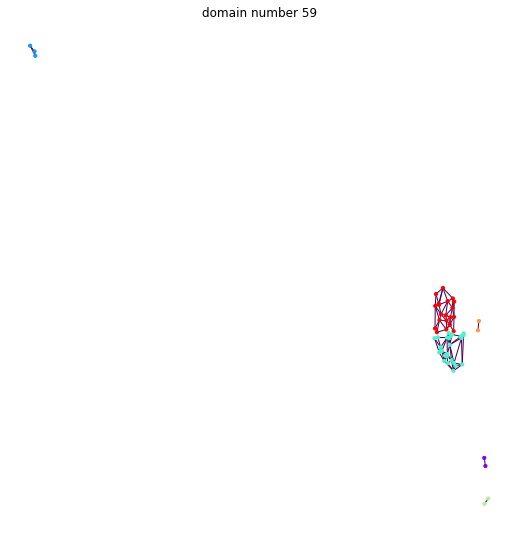

-----------------------------------------------
---------------- domain number 60 ----------------


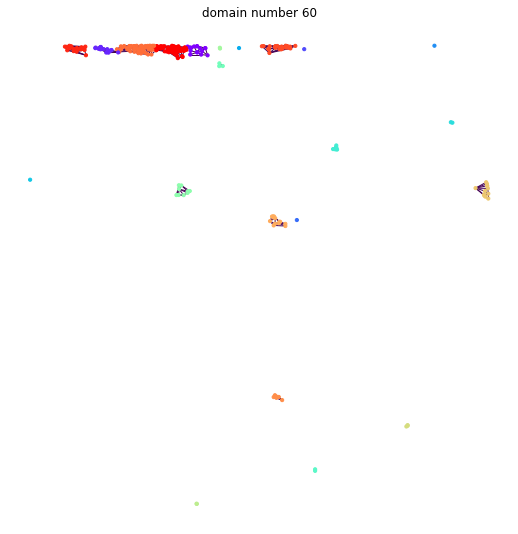

-----------------------------------------------
---------------- domain number 61 ----------------


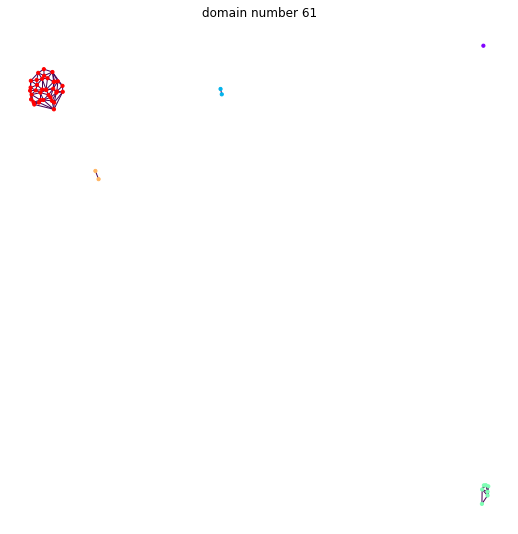

-----------------------------------------------
---------------- domain number 62 ----------------


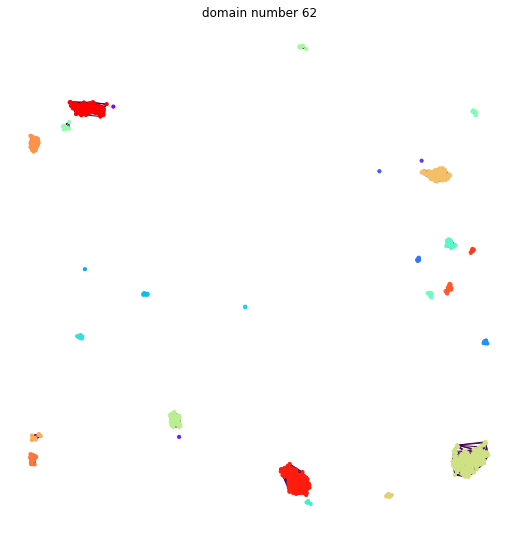

-----------------------------------------------
---------------- domain number 63 ----------------


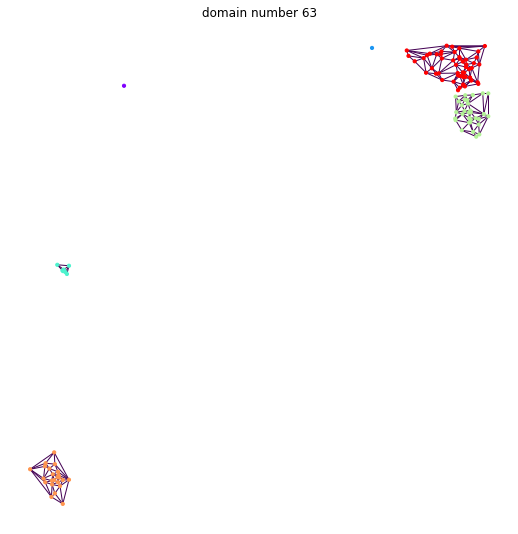

-----------------------------------------------
---------------- domain number 64 ----------------


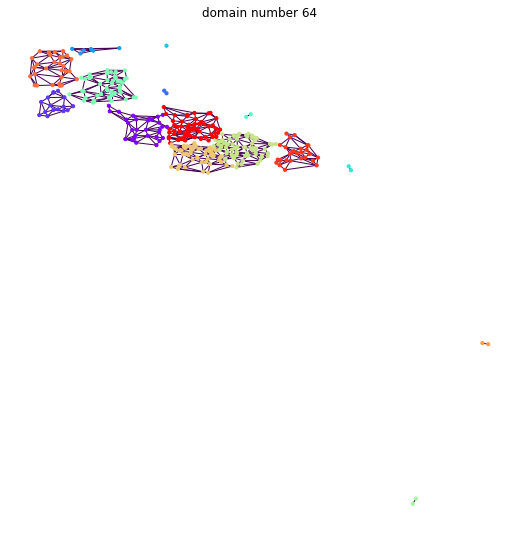

-----------------------------------------------
---------------- domain number 65 ----------------


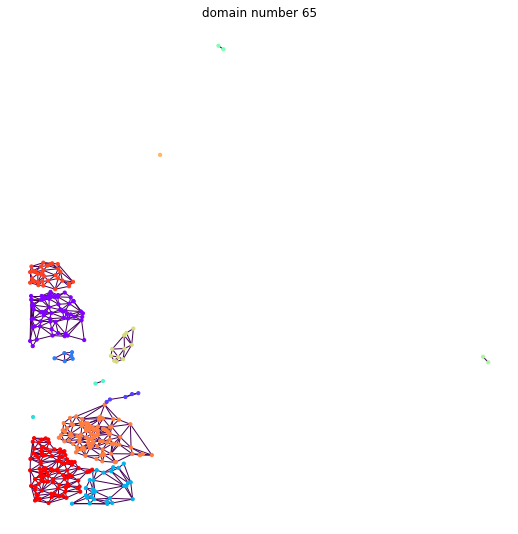

-----------------------------------------------
---------------- domain number 66 ----------------


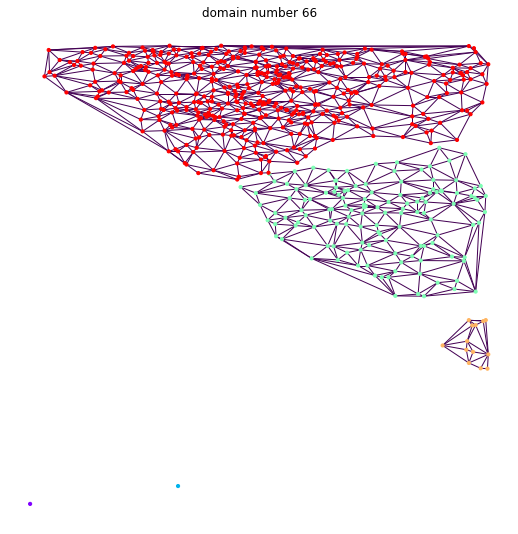

-----------------------------------------------
---------------- domain number 67 ----------------


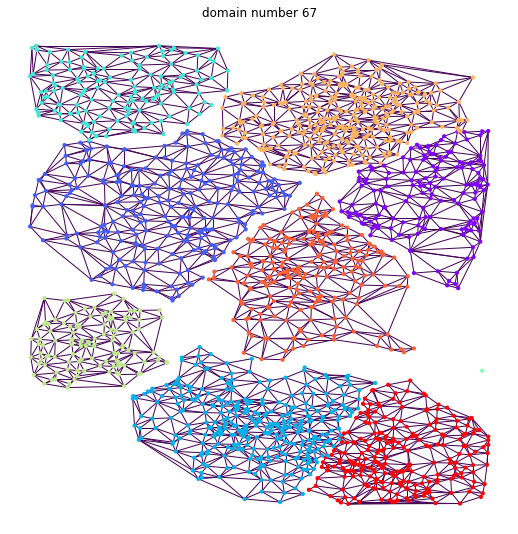

-----------------------------------------------
---------------- domain number 68 ----------------


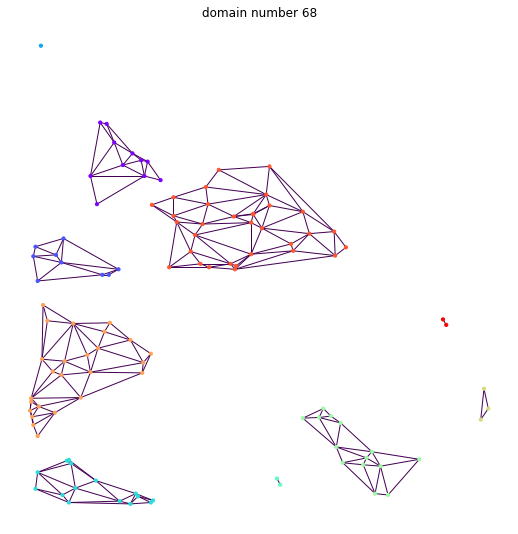

-----------------------------------------------
---------------- domain number 69 ----------------


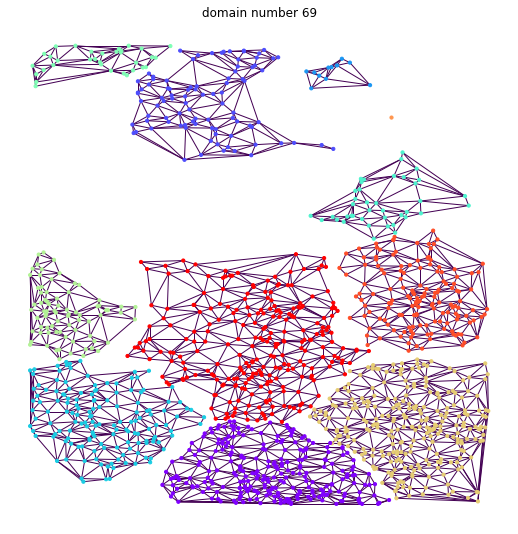

-----------------------------------------------
---------------- domain number 70 ----------------


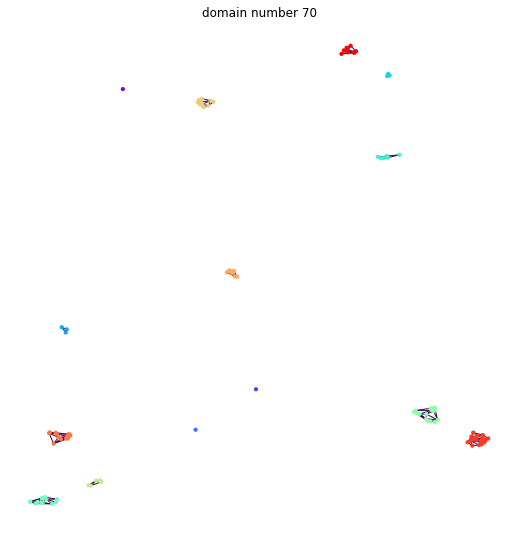

-----------------------------------------------
---------------- domain number 71 ----------------


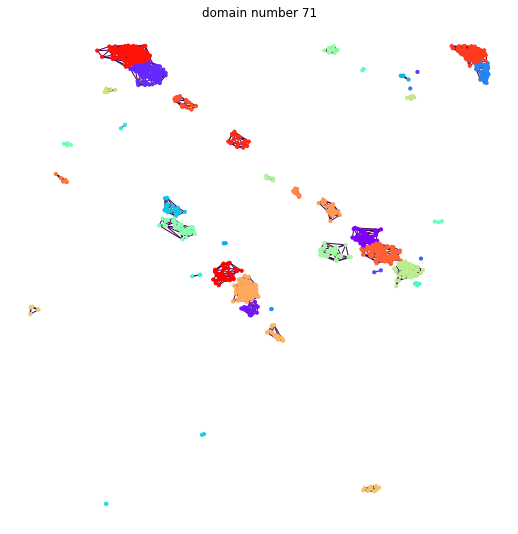

-----------------------------------------------
---------------- domain number 72 ----------------


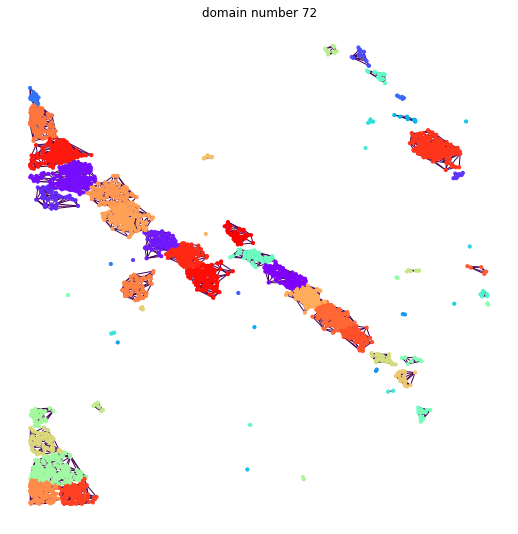

-----------------------------------------------
---------------- domain number 73 ----------------


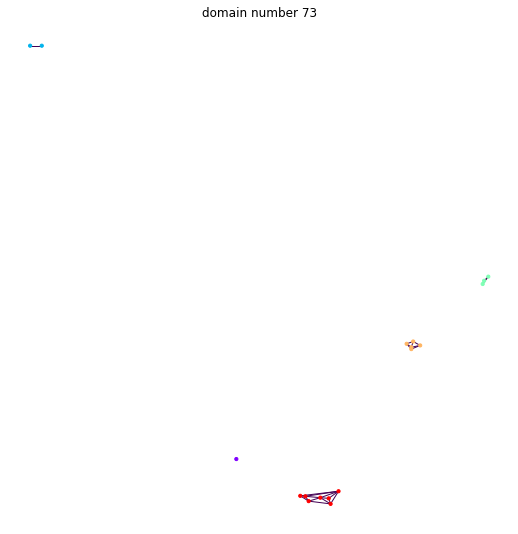

-----------------------------------------------
---------------- domain number 74 ----------------


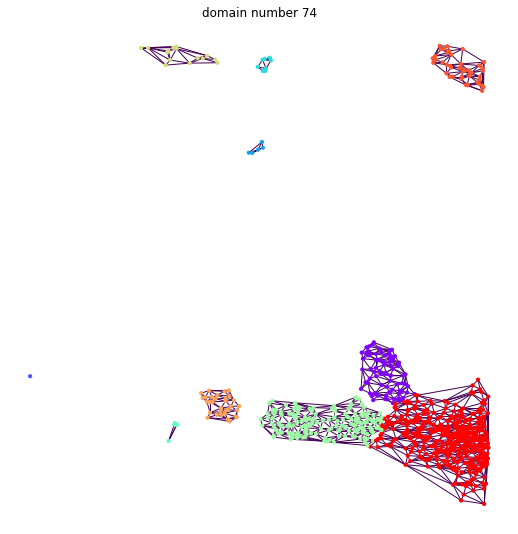

-----------------------------------------------
---------------- domain number 75 ----------------


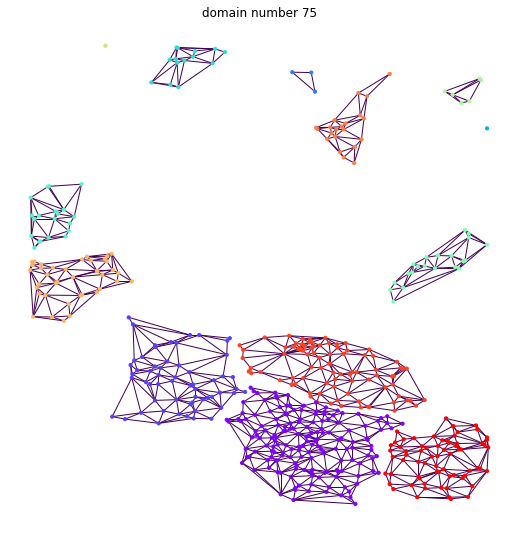

-----------------------------------------------
---------------- domain number 76 ----------------


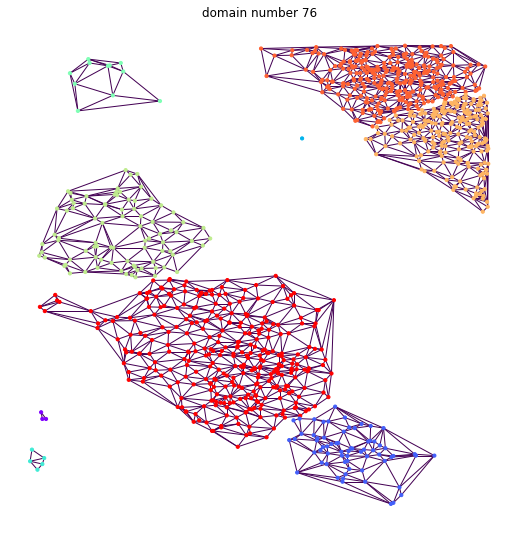

-----------------------------------------------
---------------- domain number 77 ----------------


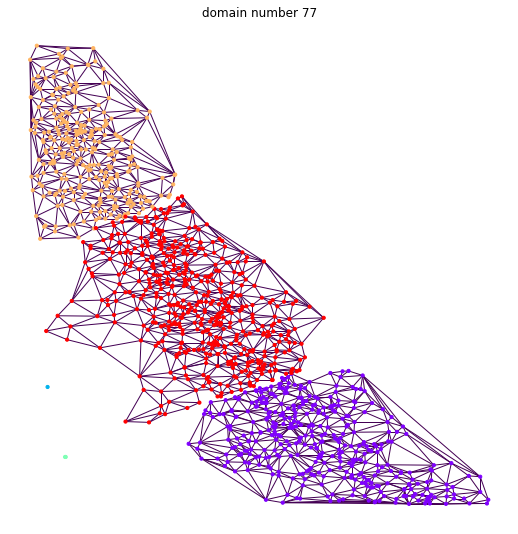

-----------------------------------------------
---------------- domain number 78 ----------------


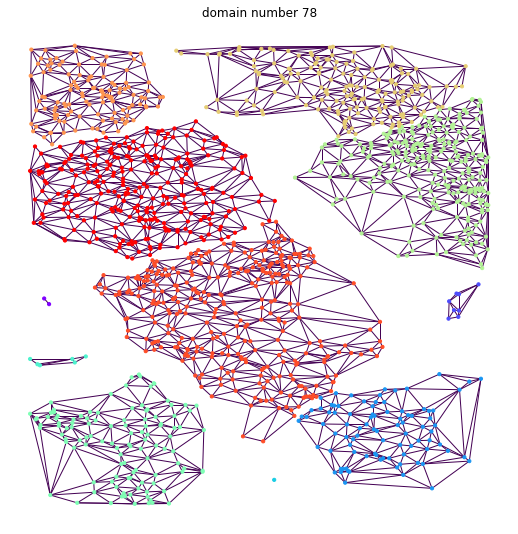

-----------------------------------------------
---------------- domain number 79 ----------------


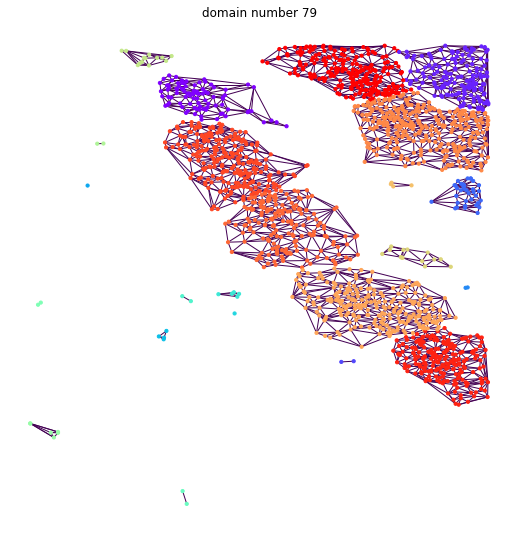

-----------------------------------------------
---------------- domain number 80 ----------------


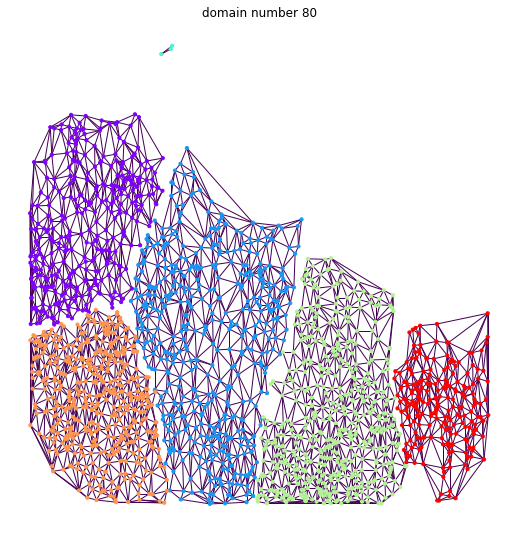

-----------------------------------------------
---------------- domain number 81 ----------------


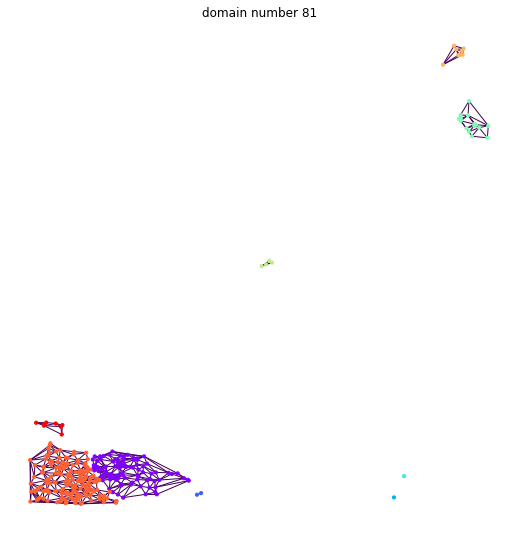

-----------------------------------------------
---------------- domain number 82 ----------------


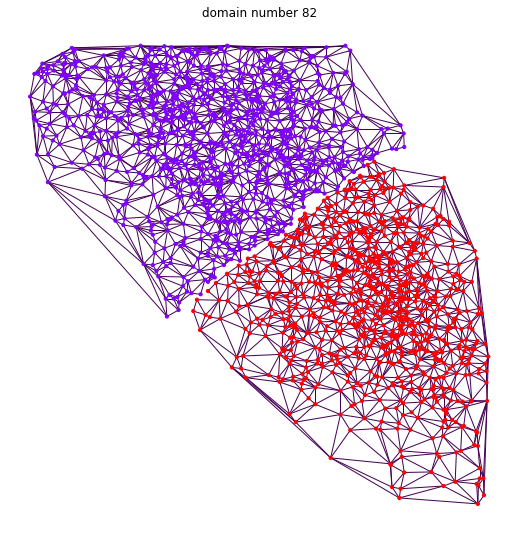

-----------------------------------------------
---------------- domain number 83 ----------------


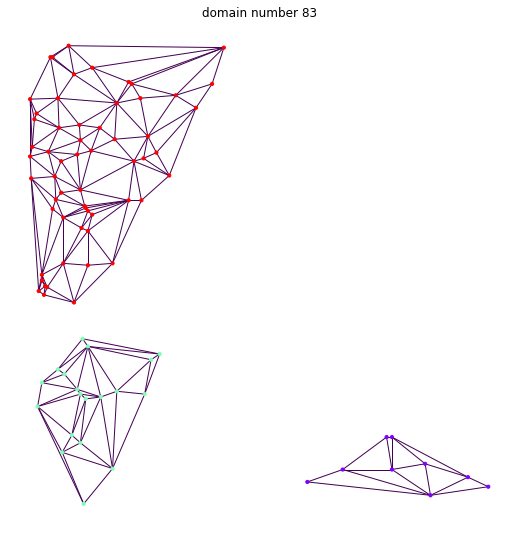

-----------------------------------------------
---------------- domain number 84 ----------------


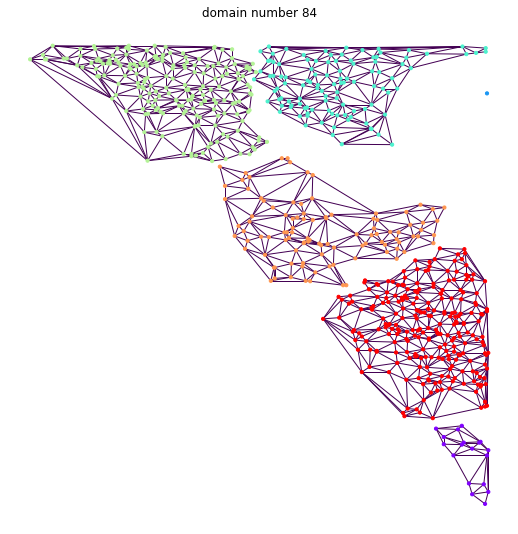

-----------------------------------------------
---------------- domain number 85 ----------------


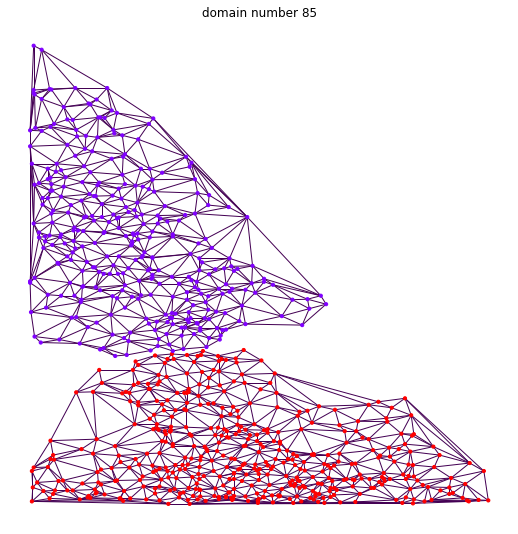

-----------------------------------------------
---------------- domain number 86 ----------------


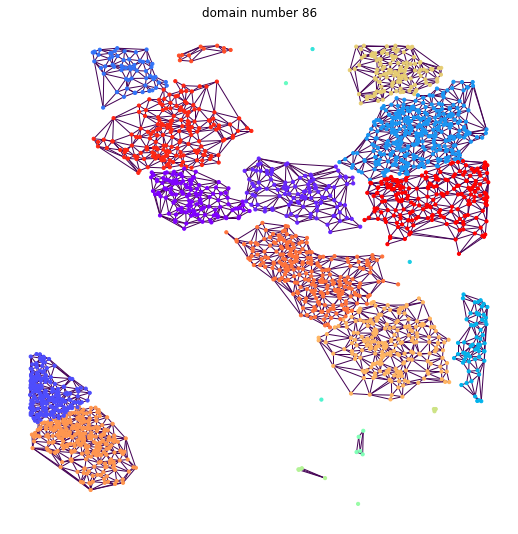

-----------------------------------------------
---------------- domain number 87 ----------------


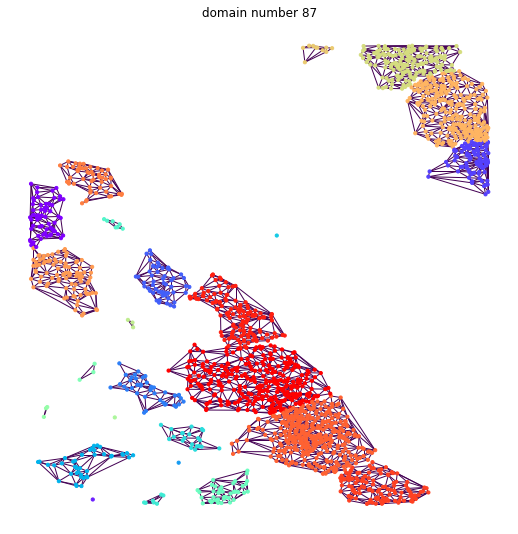

-----------------------------------------------
---------------- domain number 88 ----------------


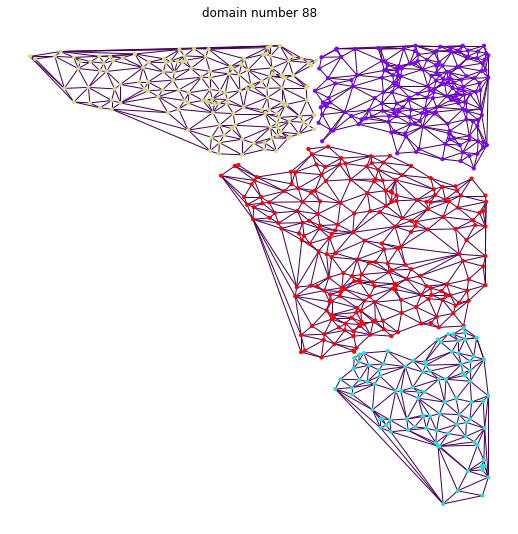

-----------------------------------------------
---------------- domain number 89 ----------------


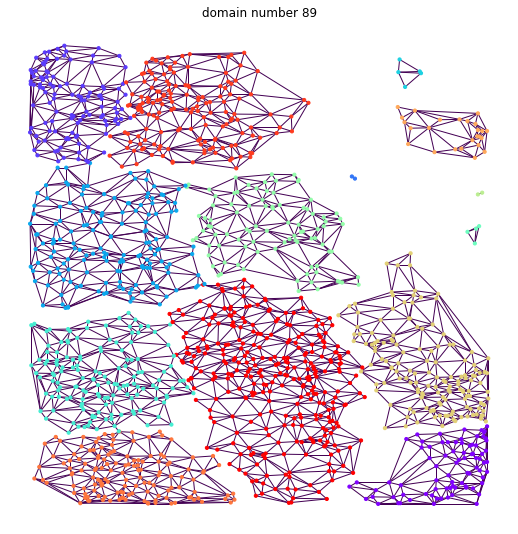

-----------------------------------------------
---------------- domain number 90 ----------------


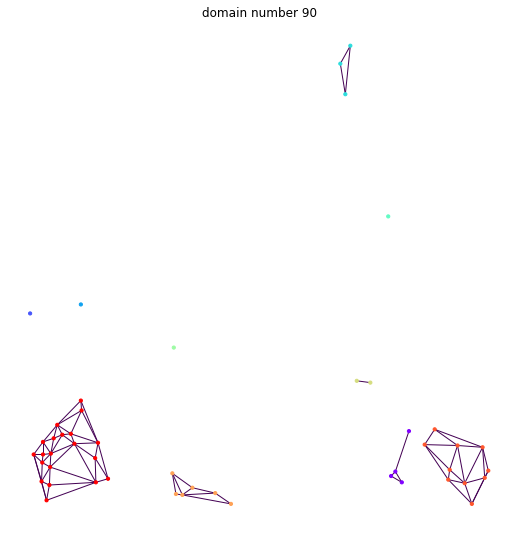

-----------------------------------------------
---------------- domain number 91 ----------------


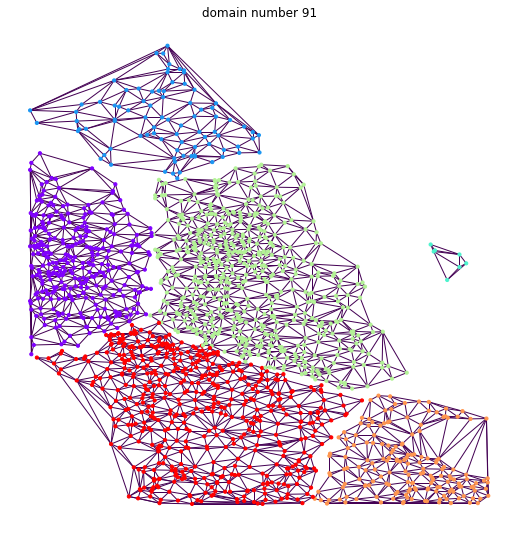

-----------------------------------------------
---------------- domain number 92 ----------------


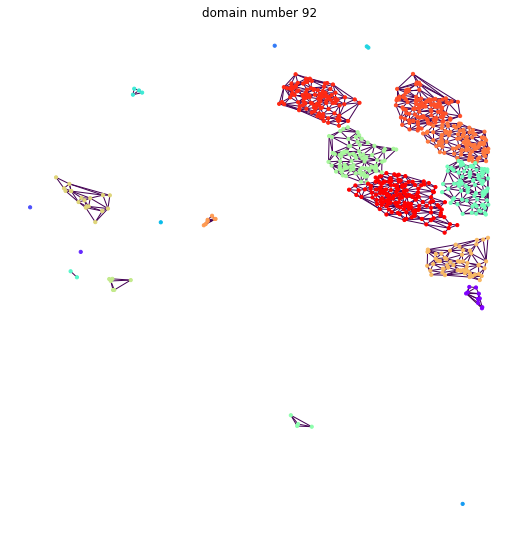

-----------------------------------------------
---------------- domain number 93 ----------------


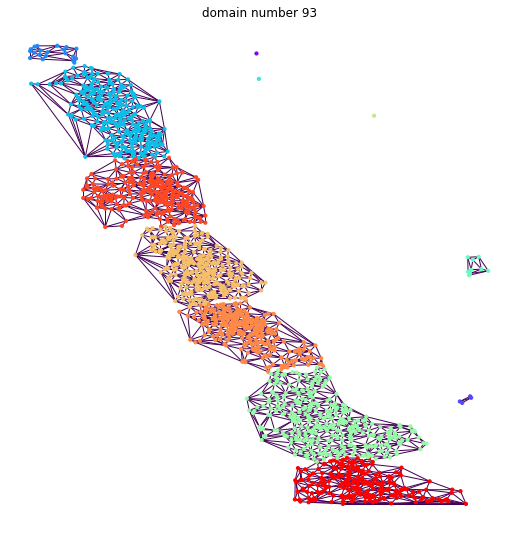

-----------------------------------------------
---------------- domain number 94 ----------------


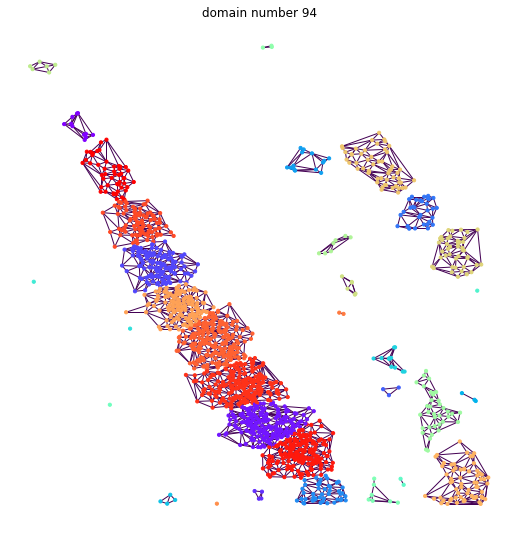

-----------------------------------------------
---------------- domain number 95 ----------------


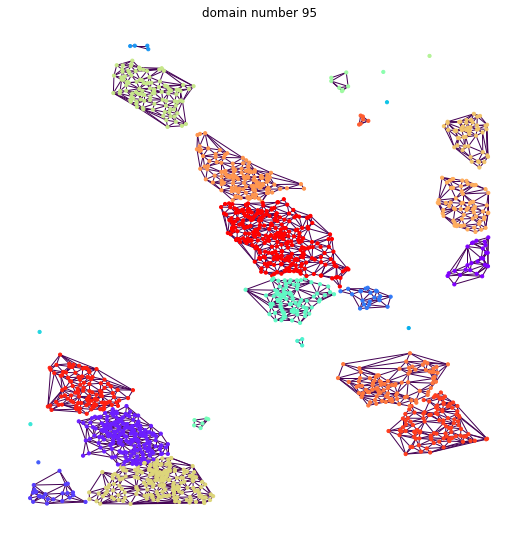

-----------------------------------------------
---------------- domain number 96 ----------------


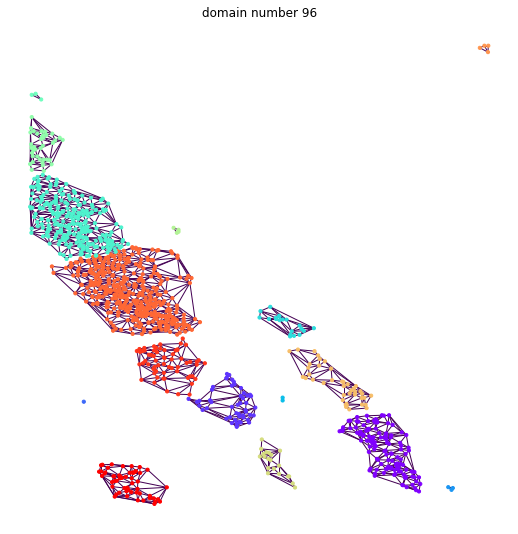

-----------------------------------------------
---------------- domain number 97 ----------------


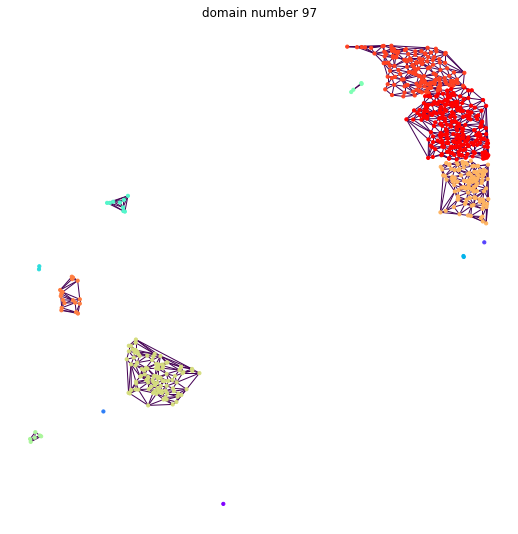

-----------------------------------------------
---------------- domain number 98 ----------------


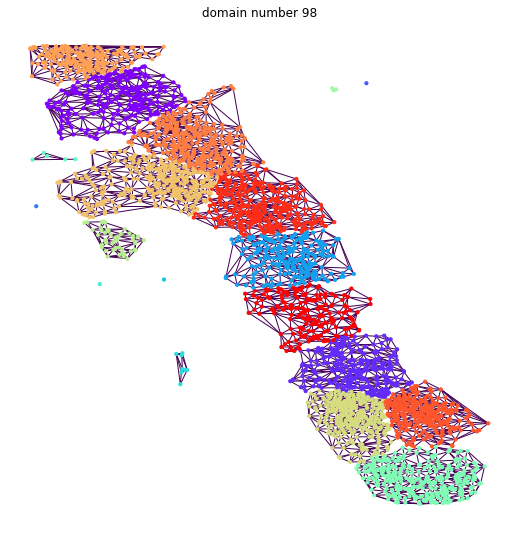

-----------------------------------------------
---------------- domain number 99 ----------------


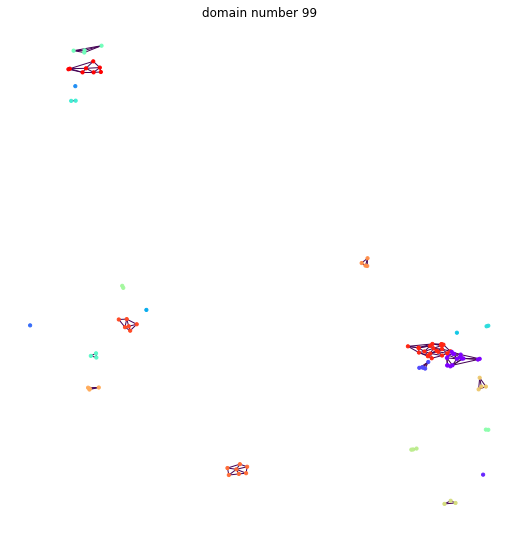

-----------------------------------------------
---------------- domain number 100 ----------------


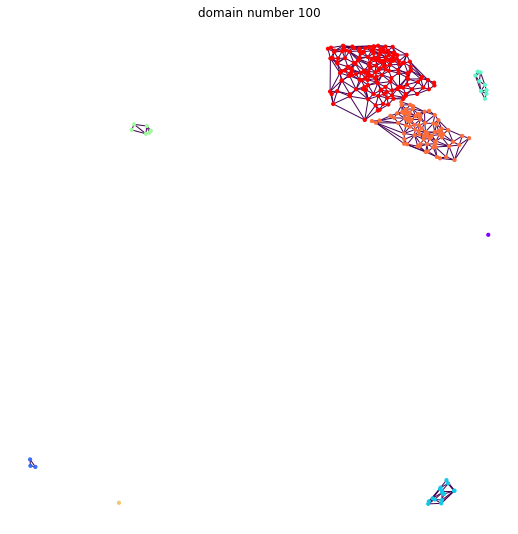

-----------------------------------------------
---------------- domain number 101 ----------------


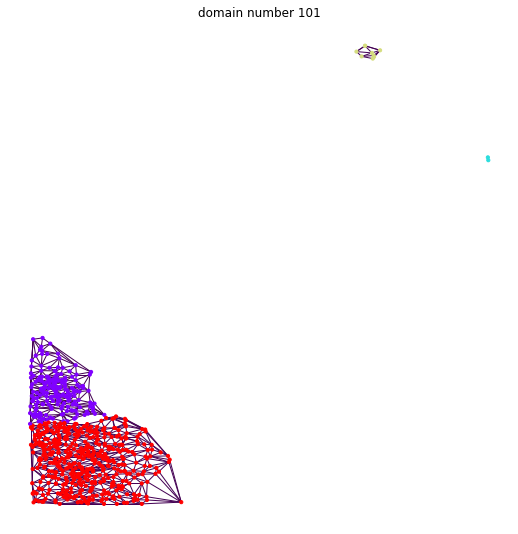

-----------------------------------------------
---------------- domain number 102 ----------------


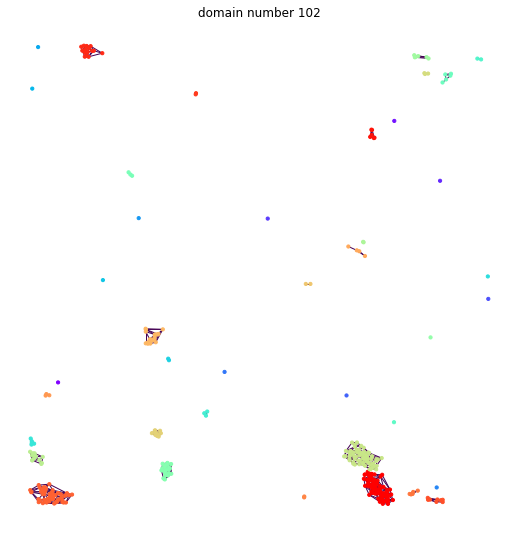

-----------------------------------------------
---------------- domain number 103 ----------------


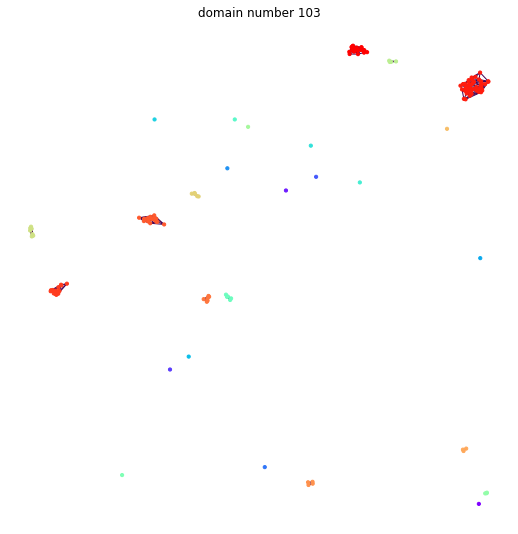

-----------------------------------------------
---------------- domain number 104 ----------------


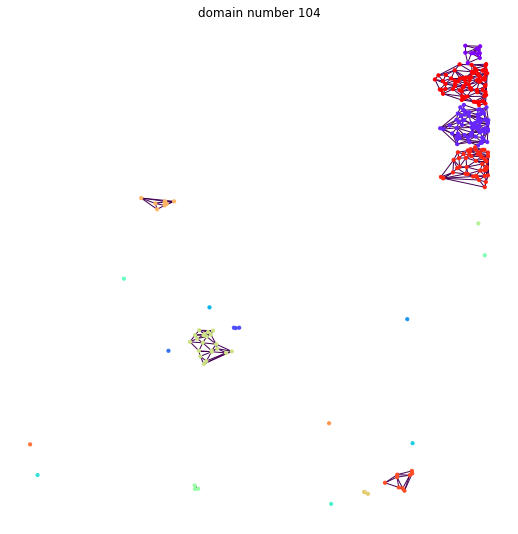

-----------------------------------------------
---------------- domain number 105 ----------------


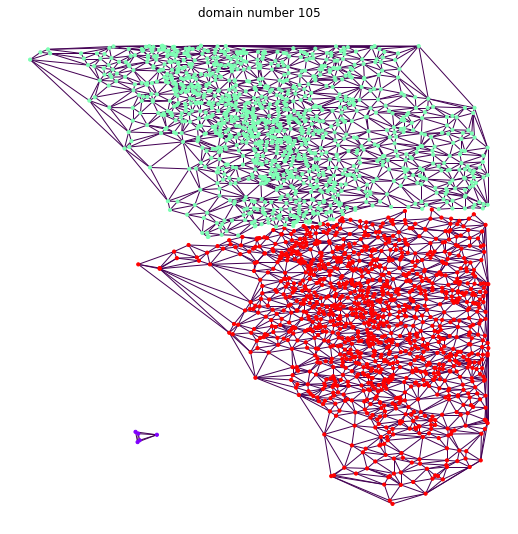

-----------------------------------------------
---------------- domain number 106 ----------------


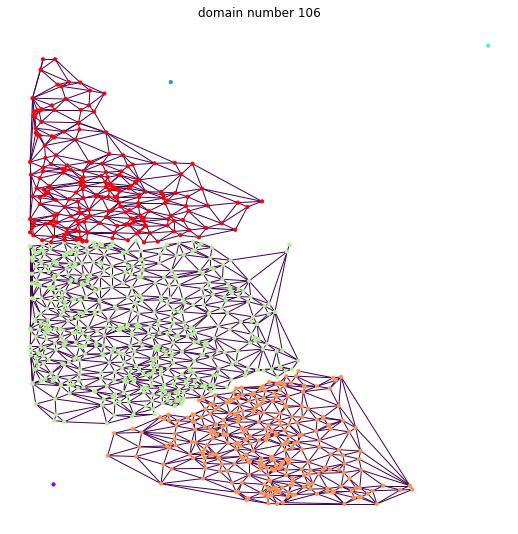

-----------------------------------------------
---------------- domain number 107 ----------------
-----------------------------------------------
---------------- domain number 108 ----------------


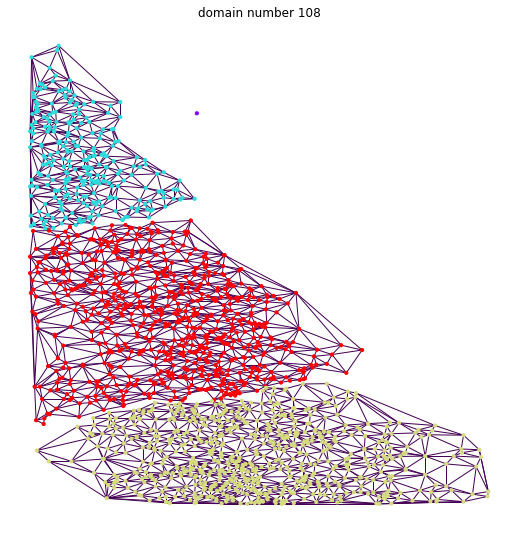

-----------------------------------------------
---------------- domain number 109 ----------------


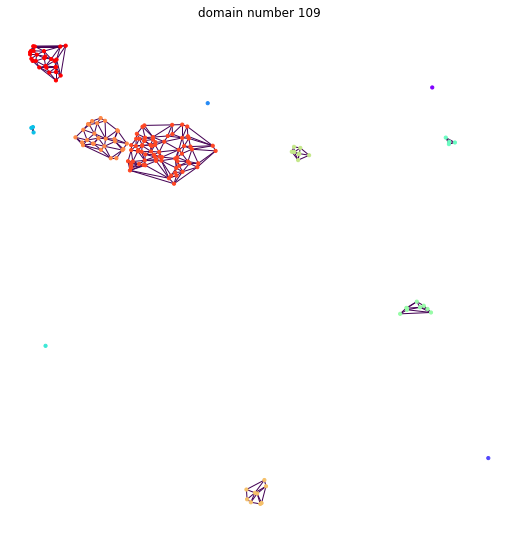

-----------------------------------------------
---------------- domain number 110 ----------------


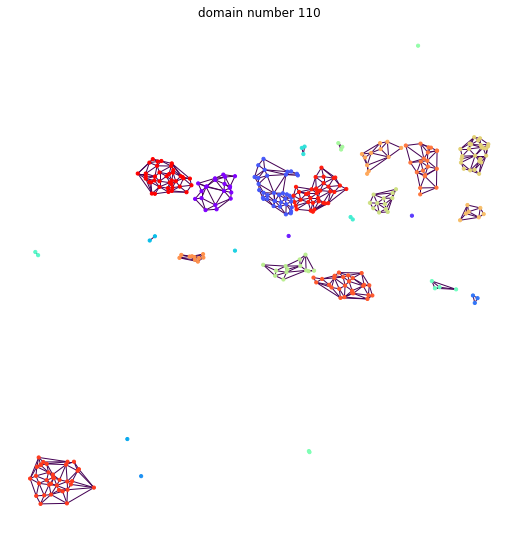

-----------------------------------------------
---------------- domain number 111 ----------------


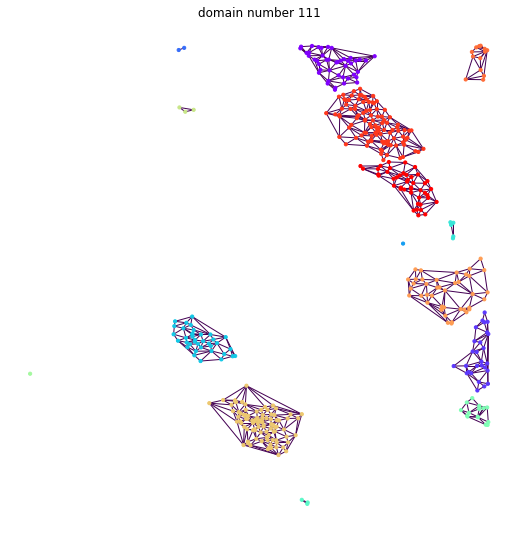

-----------------------------------------------
---------------- domain number 112 ----------------


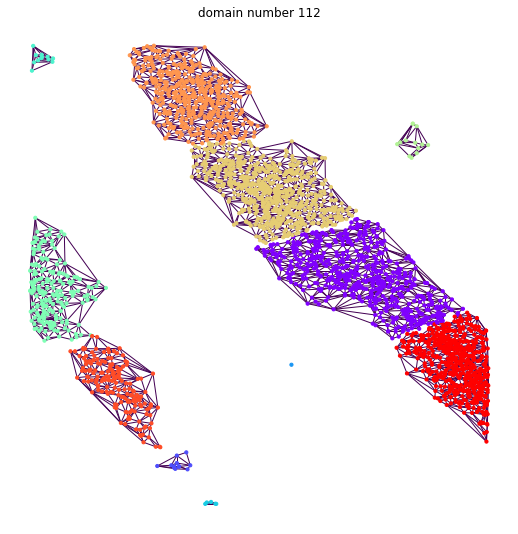

-----------------------------------------------
---------------- domain number 113 ----------------


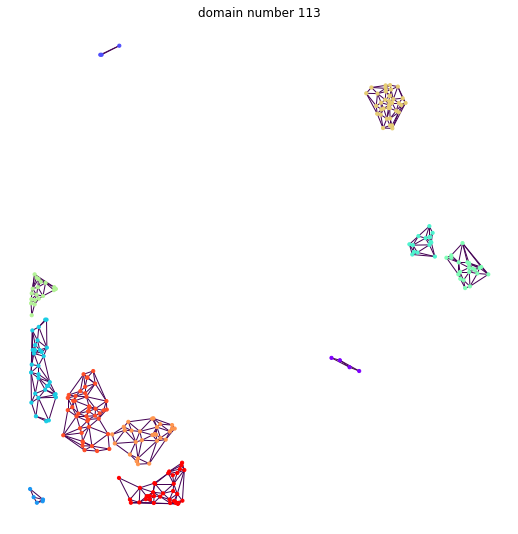

-----------------------------------------------
---------------- domain number 114 ----------------


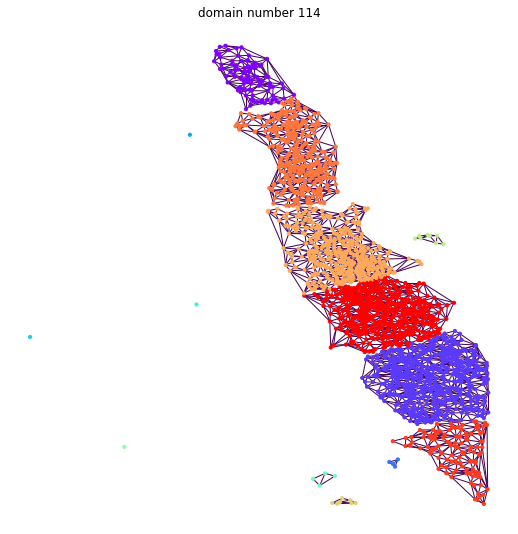

-----------------------------------------------
---------------- domain number 115 ----------------


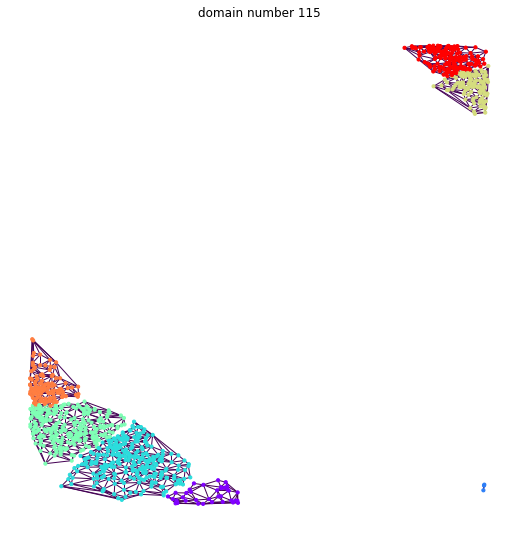

-----------------------------------------------
---------------- domain number 116 ----------------


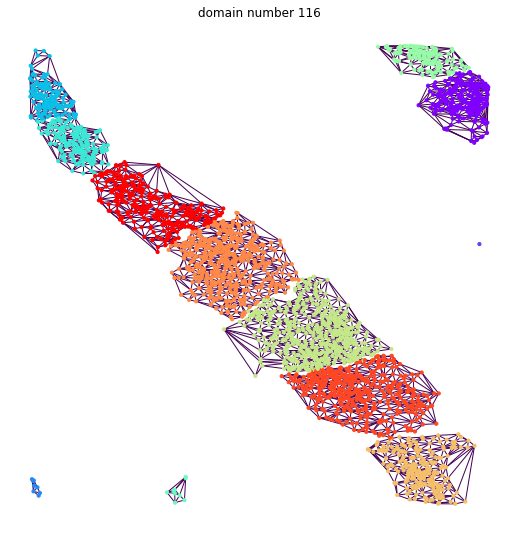

-----------------------------------------------
---------------- domain number 117 ----------------


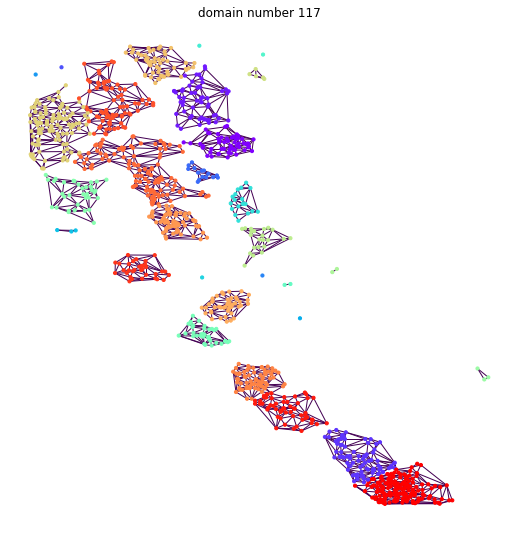

-----------------------------------------------
---------------- domain number 118 ----------------


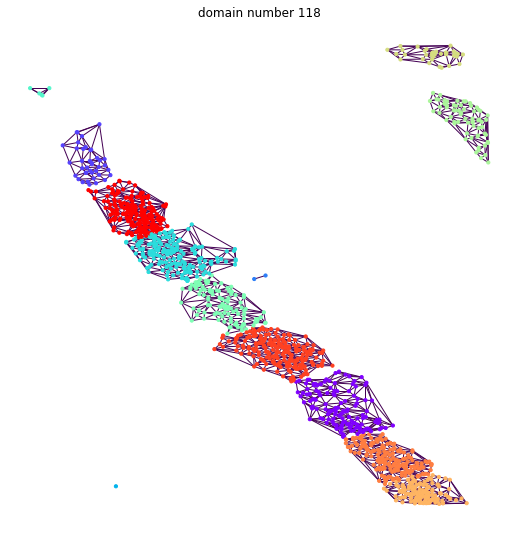

-----------------------------------------------
---------------- domain number 119 ----------------


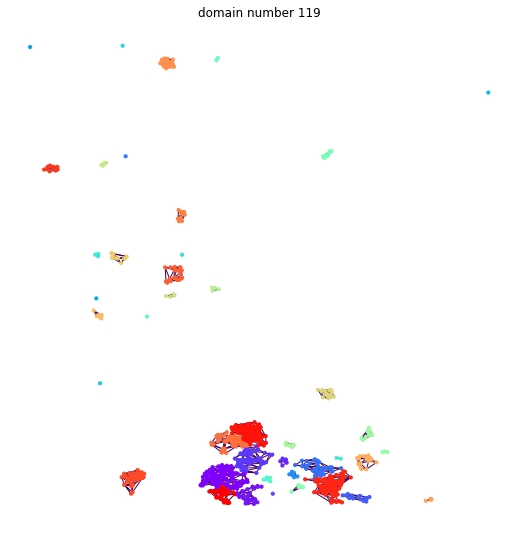

-----------------------------------------------
---------------- domain number 120 ----------------


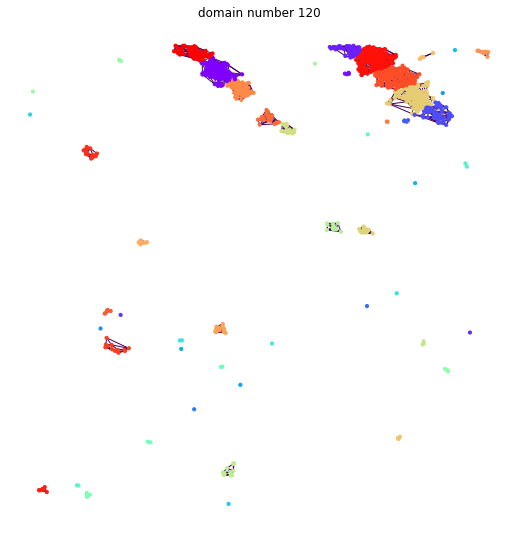

-----------------------------------------------
---------------- domain number 121 ----------------


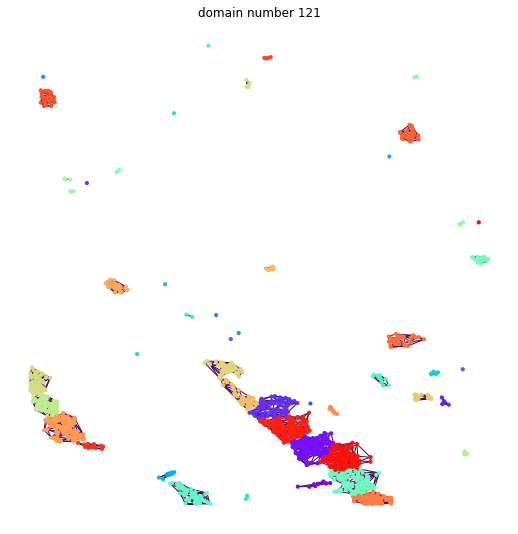

-----------------------------------------------
---------------- domain number 122 ----------------


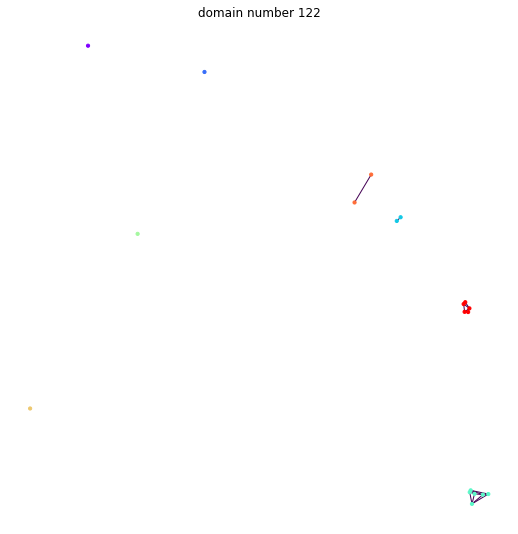

-----------------------------------------------
---------------- domain number 123 ----------------


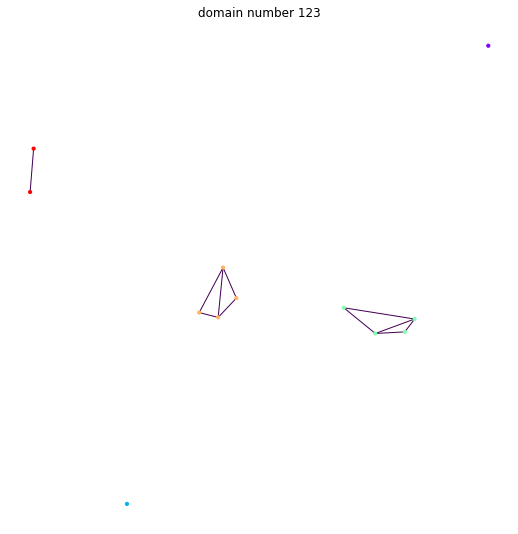

-----------------------------------------------
---------------- domain number 124 ----------------


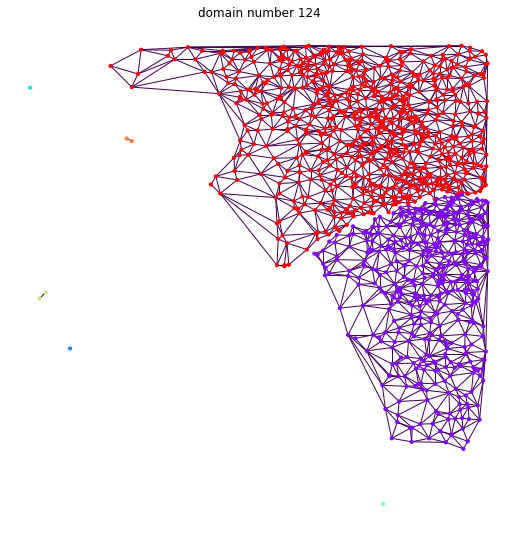

-----------------------------------------------
---------------- domain number 125 ----------------


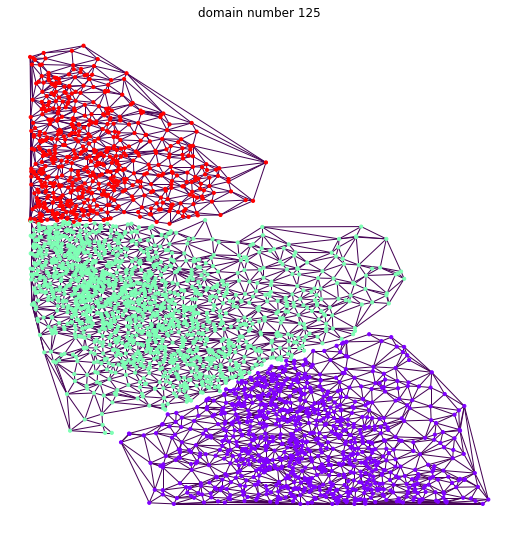

-----------------------------------------------
---------------- domain number 126 ----------------


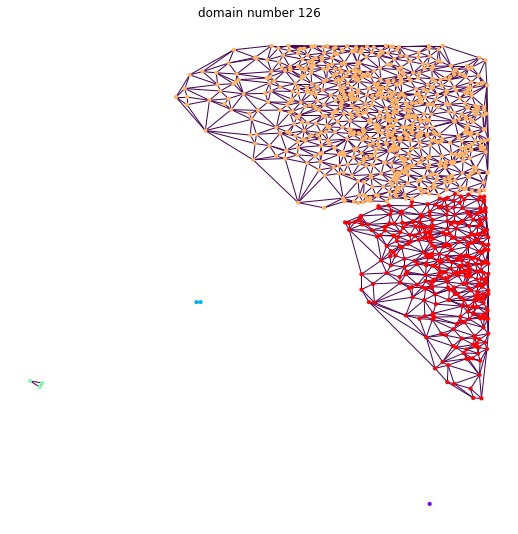

-----------------------------------------------
---------------- domain number 127 ----------------


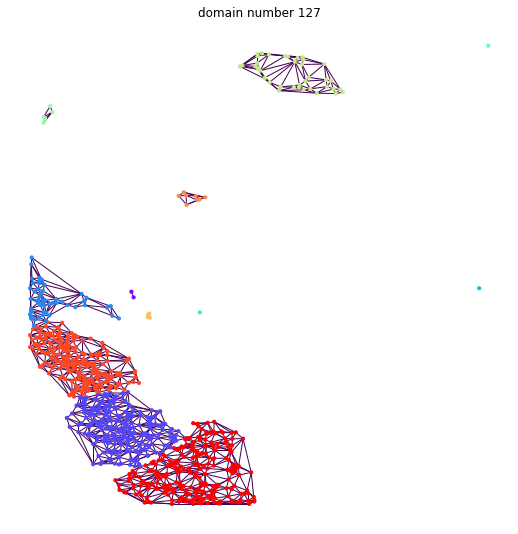

-----------------------------------------------
---------------- domain number 128 ----------------


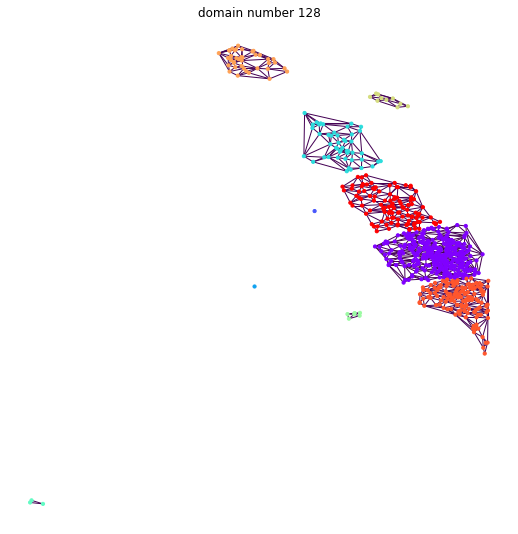

-----------------------------------------------
---------------- domain number 129 ----------------


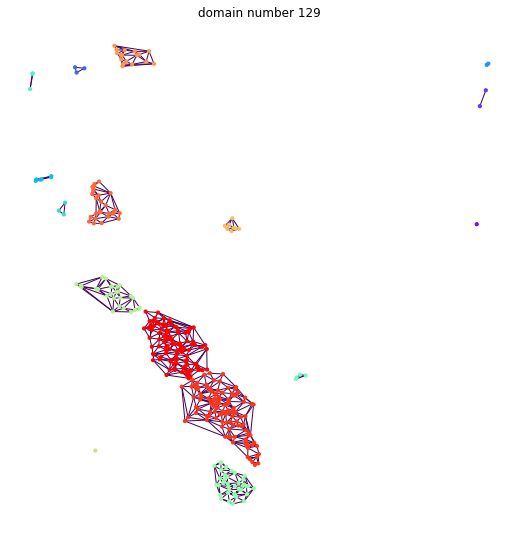

-----------------------------------------------
---------------- domain number 130 ----------------


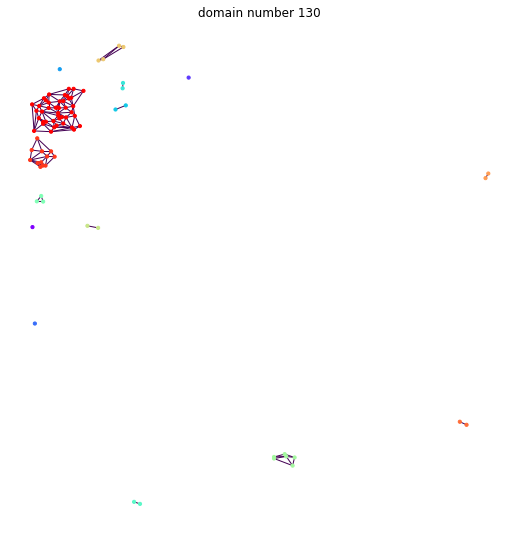

-----------------------------------------------
---------------- domain number 131 ----------------


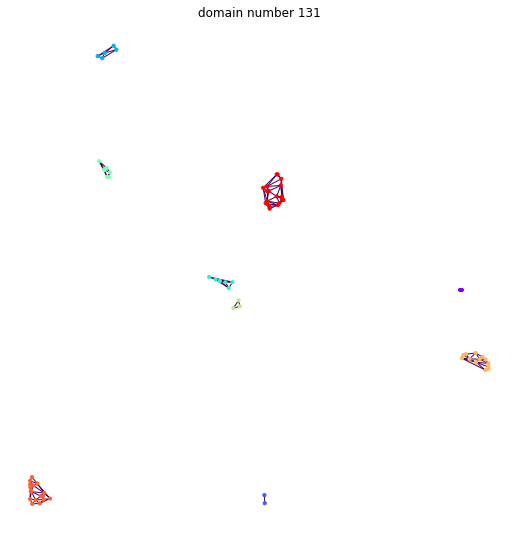

-----------------------------------------------
---------------- domain number 132 ----------------


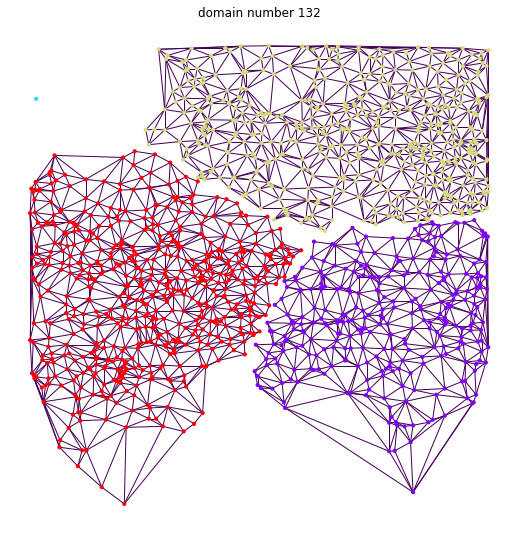

-----------------------------------------------
---------------- domain number 133 ----------------


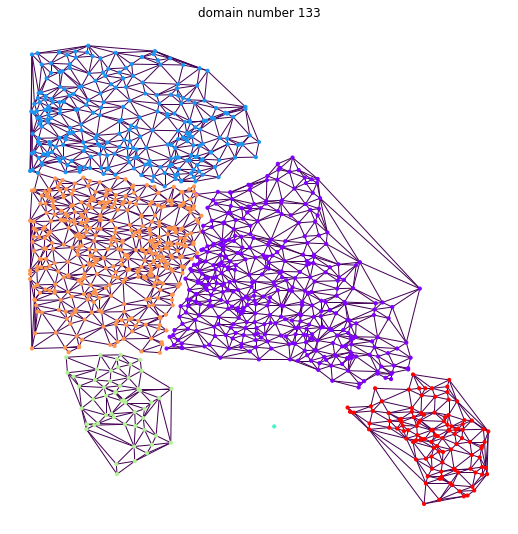

-----------------------------------------------
---------------- domain number 134 ----------------


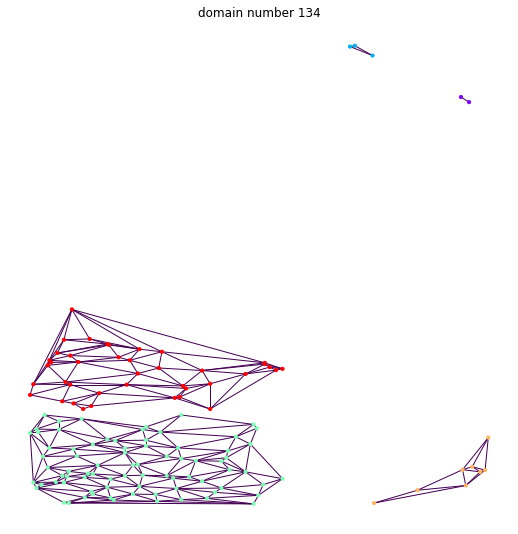

-----------------------------------------------
---------------- domain number 135 ----------------


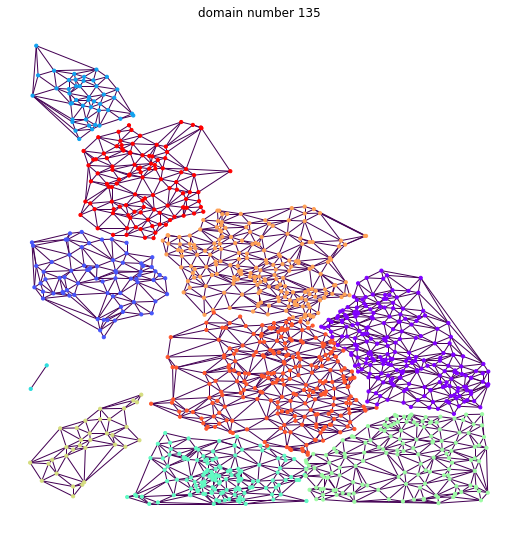

-----------------------------------------------
---------------- domain number 136 ----------------


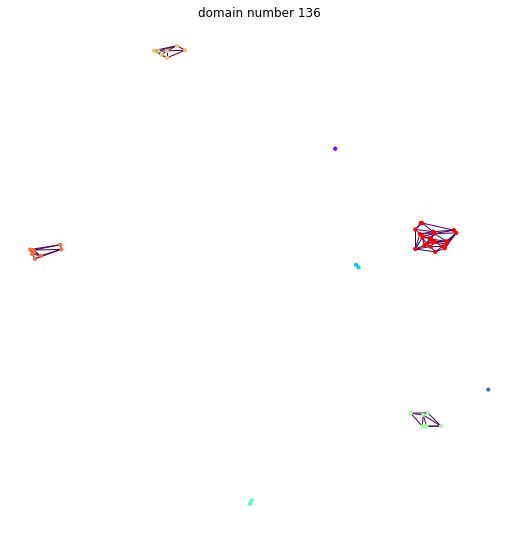

-----------------------------------------------
---------------- domain number 137 ----------------


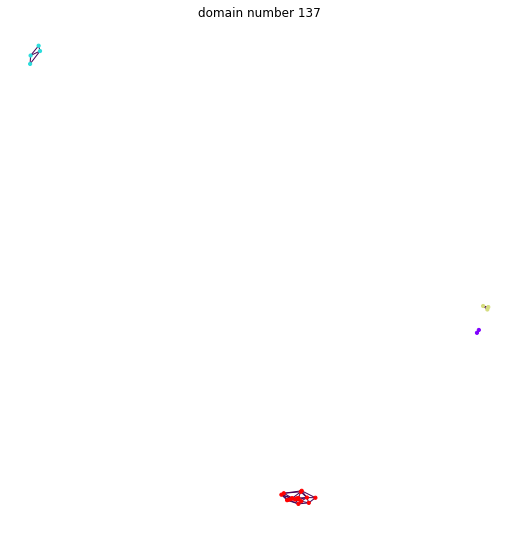

-----------------------------------------------
---------------- domain number 138 ----------------


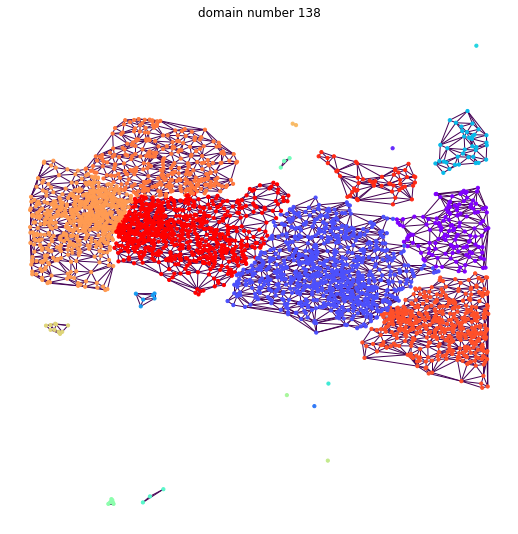

-----------------------------------------------
---------------- domain number 139 ----------------


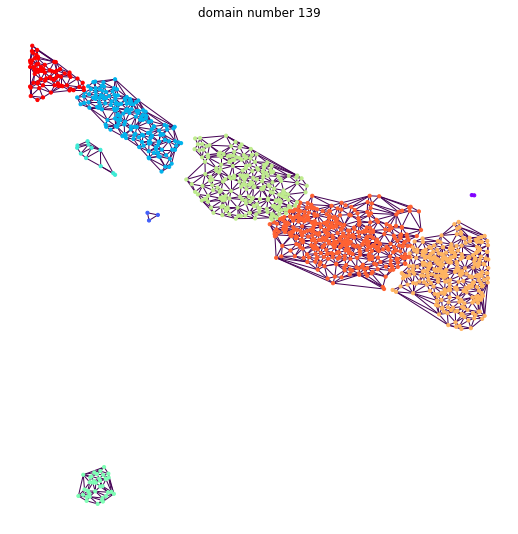

-----------------------------------------------
---------------- domain number 140 ----------------


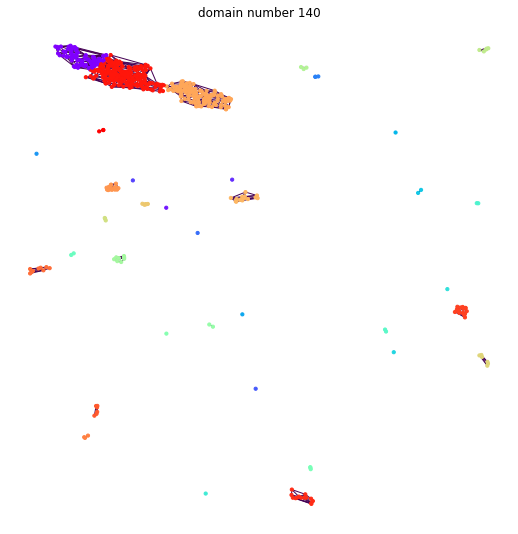

-----------------------------------------------
---------------- domain number 141 ----------------


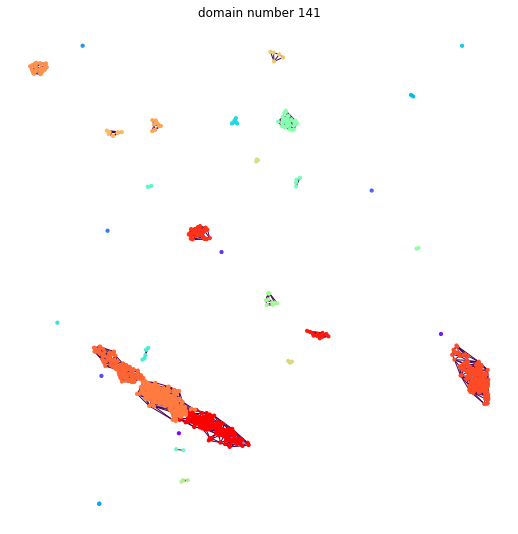

-----------------------------------------------
---------------- domain number 142 ----------------


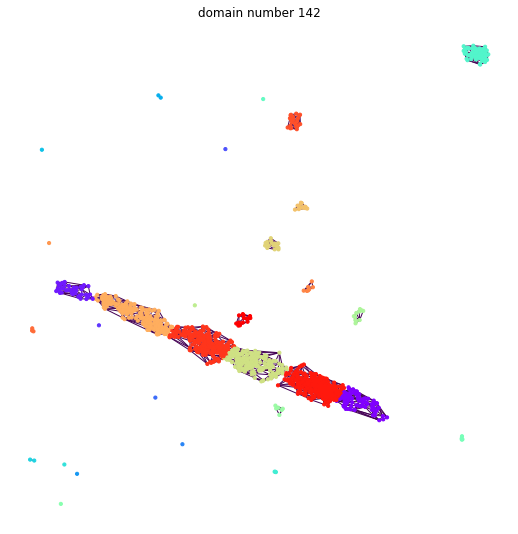

-----------------------------------------------
---------------- domain number 143 ----------------


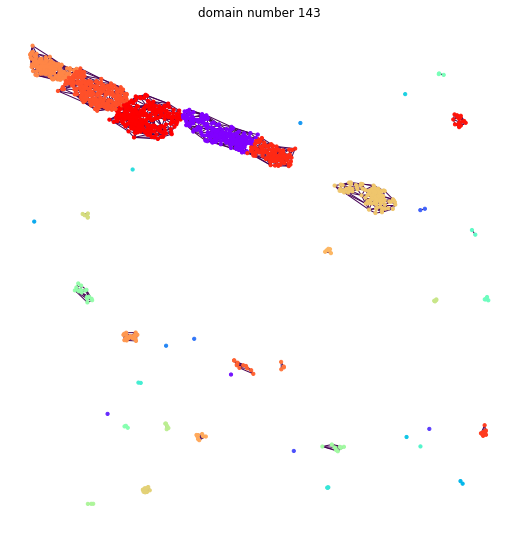

-----------------------------------------------
---------------- domain number 144 ----------------


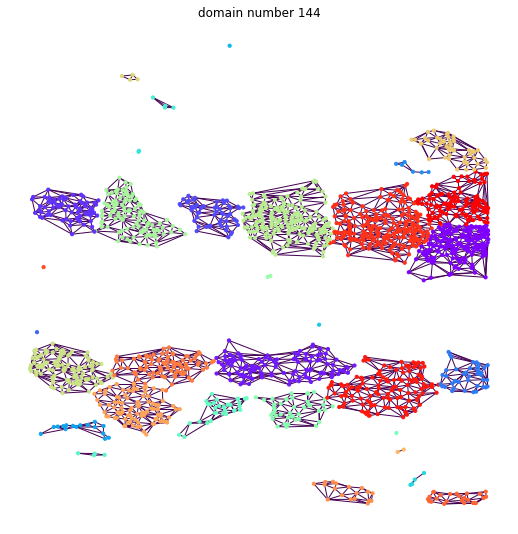

-----------------------------------------------
---------------- domain number 145 ----------------


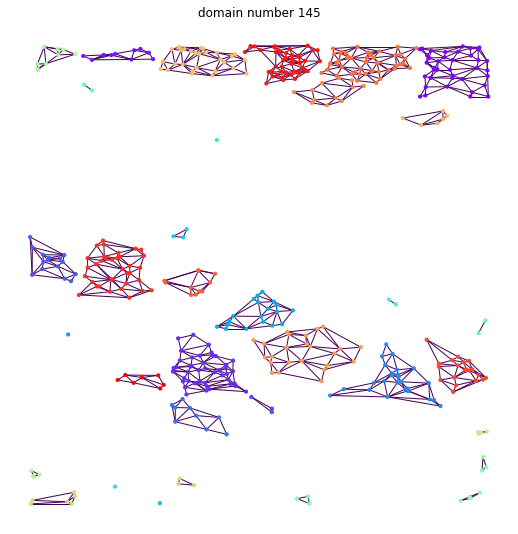

-----------------------------------------------
---------------- domain number 146 ----------------


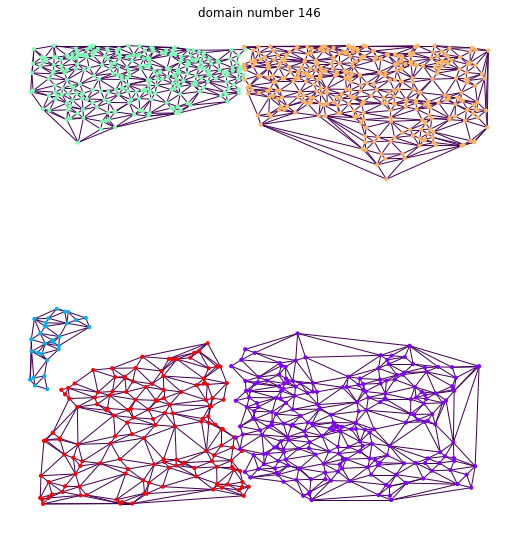

-----------------------------------------------
---------------- domain number 147 ----------------


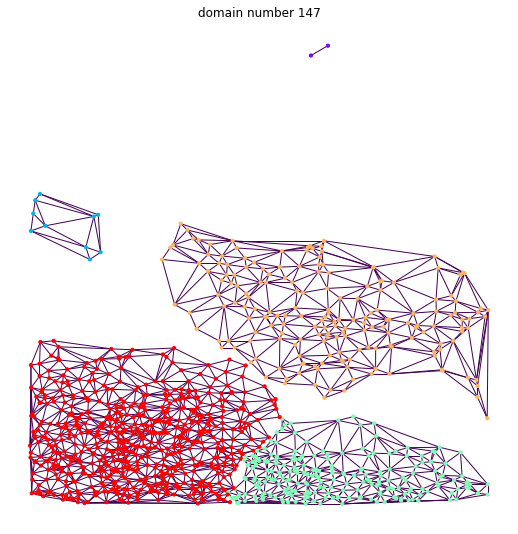

-----------------------------------------------
---------------- domain number 148 ----------------


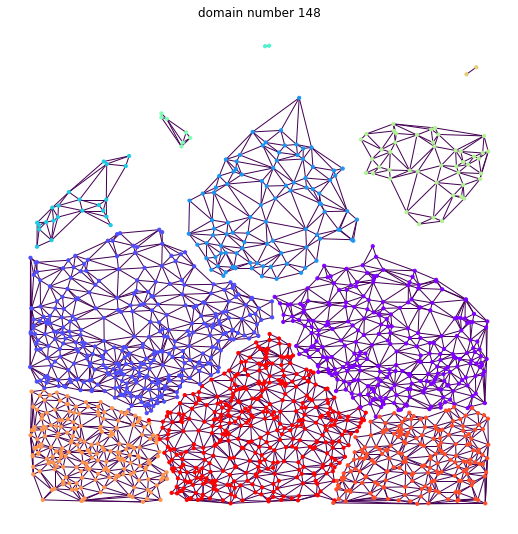

-----------------------------------------------
---------------- domain number 149 ----------------


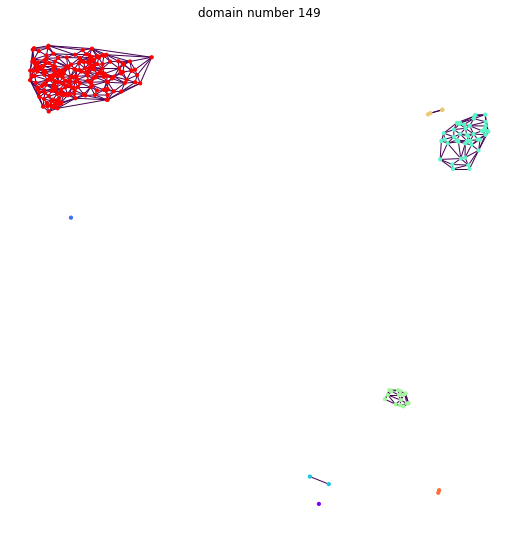

-----------------------------------------------
---------------- domain number 150 ----------------


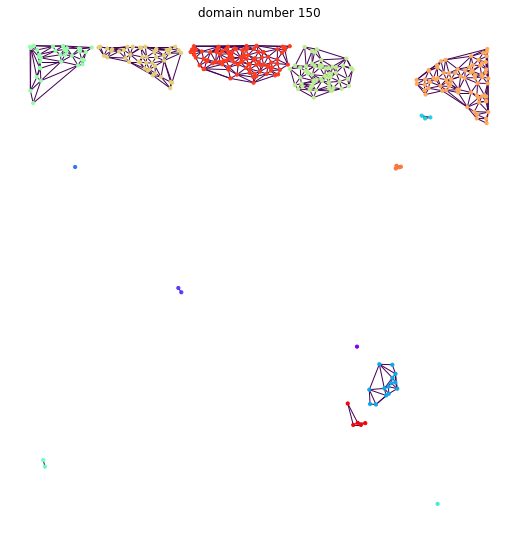

-----------------------------------------------
---------------- domain number 151 ----------------


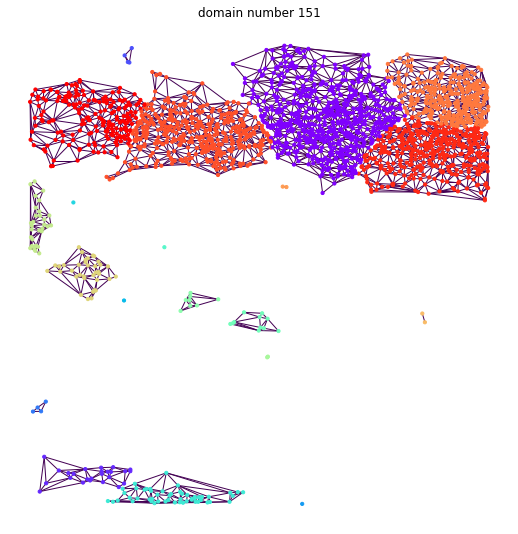

-----------------------------------------------
---------------- domain number 152 ----------------


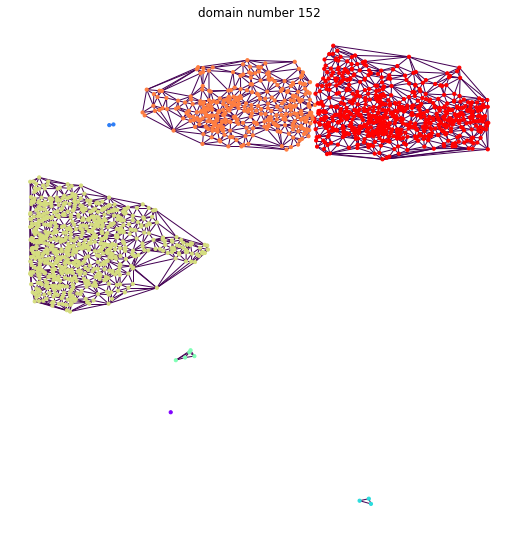

-----------------------------------------------
---------------- domain number 153 ----------------


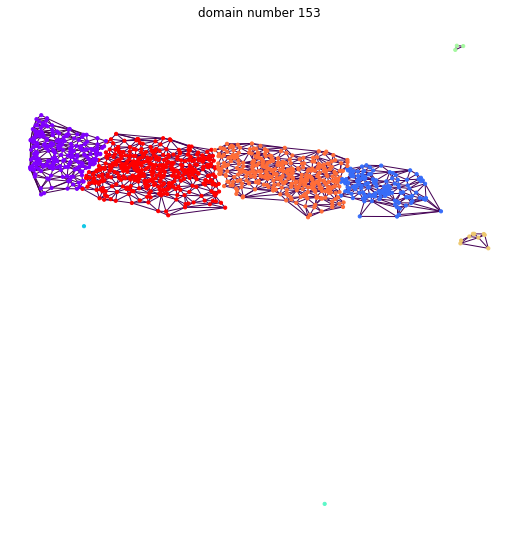

-----------------------------------------------
---------------- domain number 154 ----------------


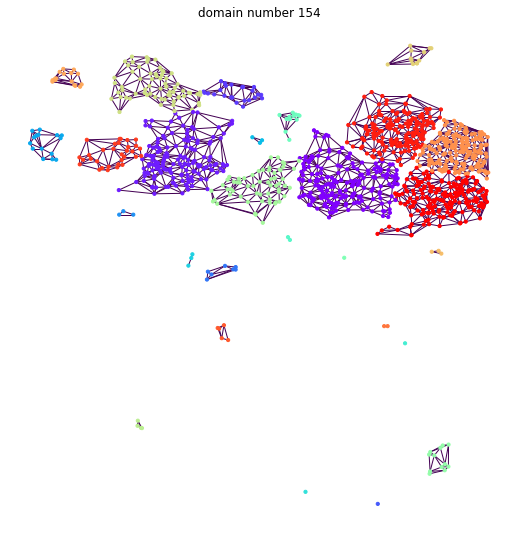

-----------------------------------------------
---------------- domain number 155 ----------------


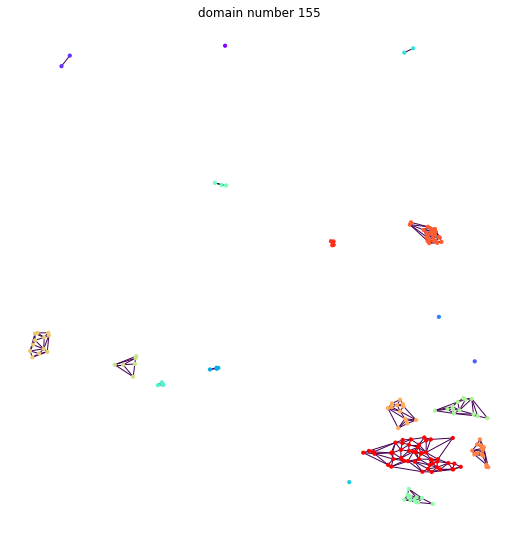

-----------------------------------------------
---------------- domain number 156 ----------------


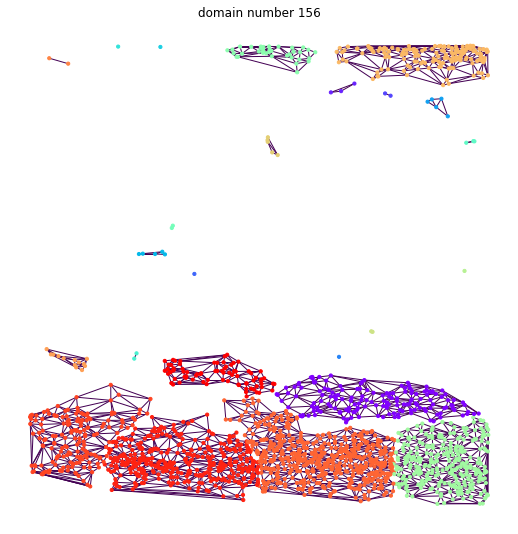

-----------------------------------------------
---------------- domain number 157 ----------------


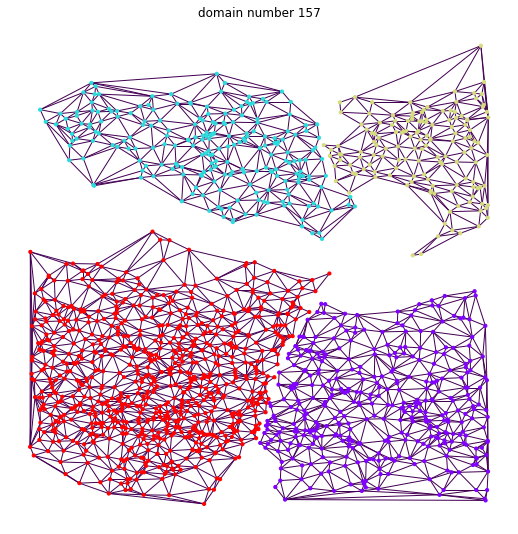

-----------------------------------------------
---------------- domain number 158 ----------------


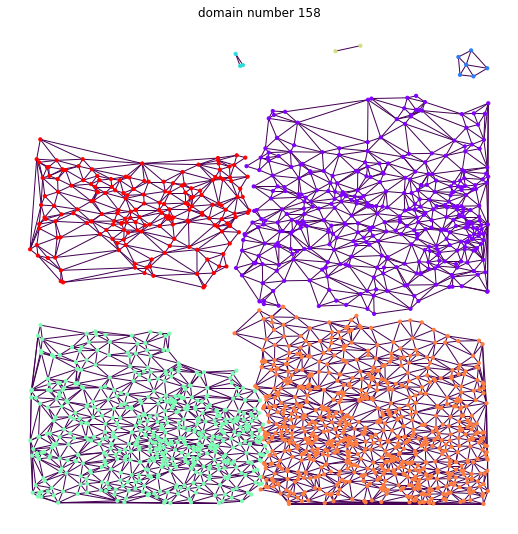

-----------------------------------------------
---------------- domain number 159 ----------------


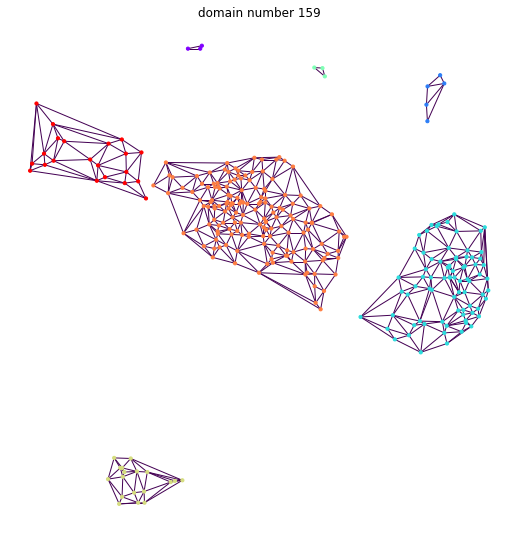

-----------------------------------------------
---------------- domain number 160 ----------------


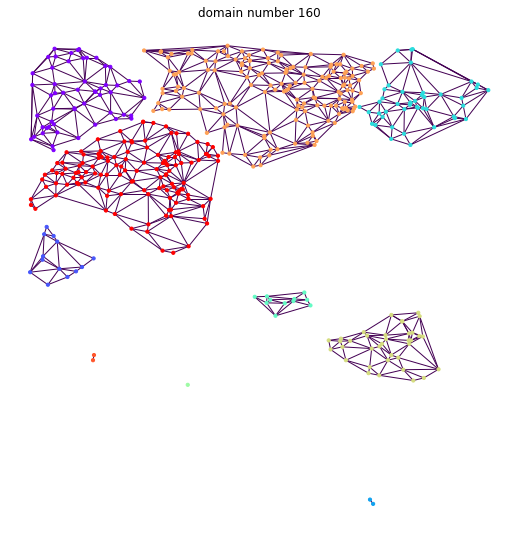

-----------------------------------------------
---------------- domain number 161 ----------------


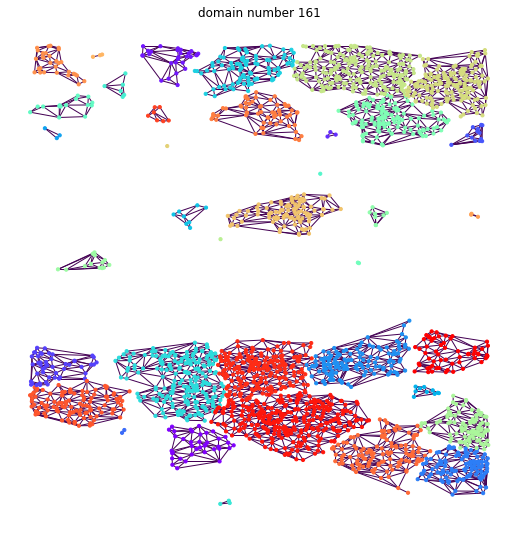

-----------------------------------------------
---------------- domain number 162 ----------------


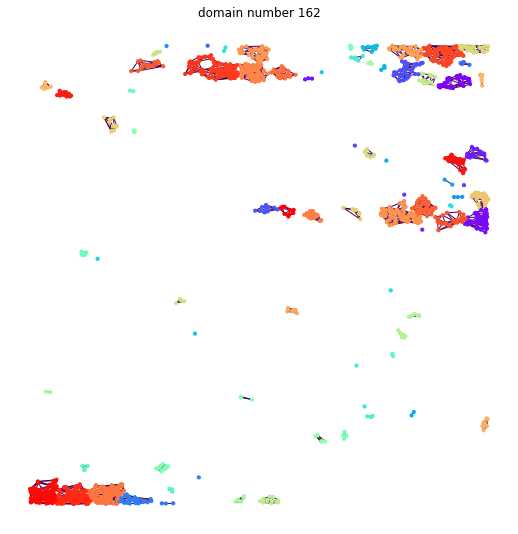

-----------------------------------------------
---------------- domain number 163 ----------------


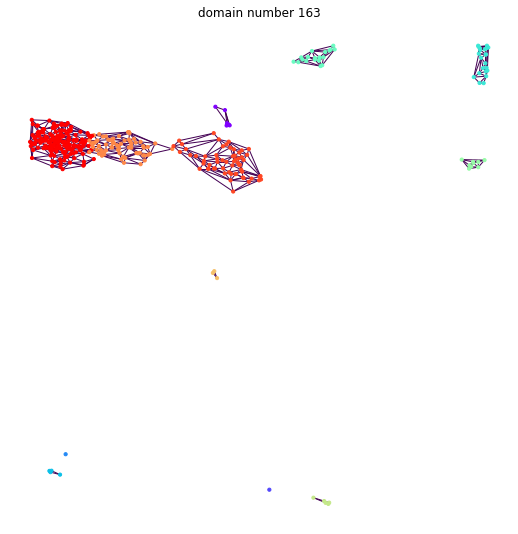

-----------------------------------------------
---------------- domain number 164 ----------------


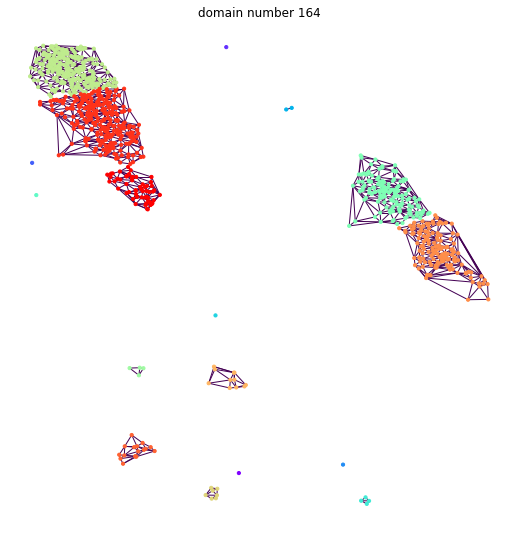

-----------------------------------------------
---------------- domain number 165 ----------------


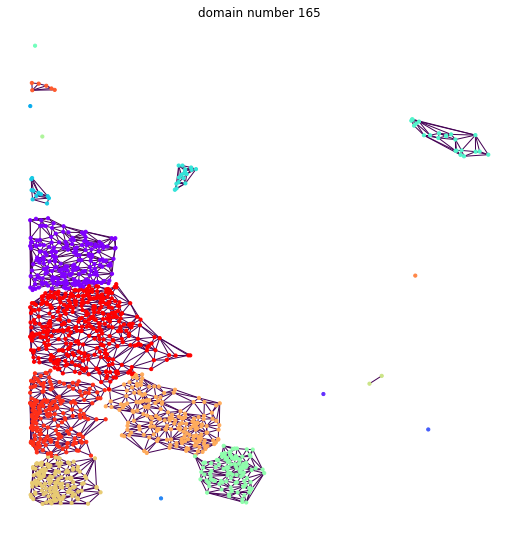

-----------------------------------------------
---------------- domain number 166 ----------------


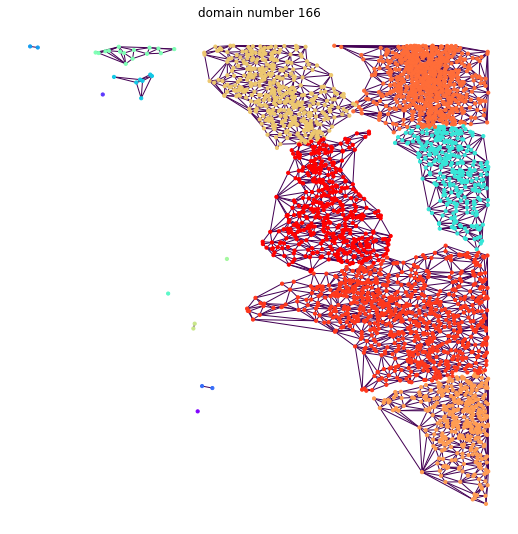

-----------------------------------------------
---------------- domain number 167 ----------------


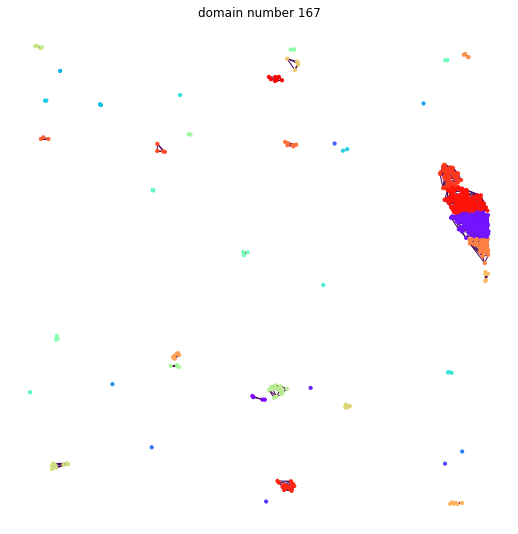

-----------------------------------------------
---------------- domain number 168 ----------------


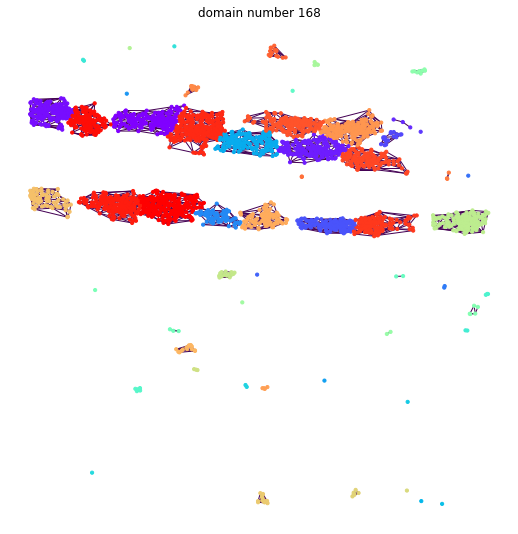

-----------------------------------------------
---------------- domain number 169 ----------------


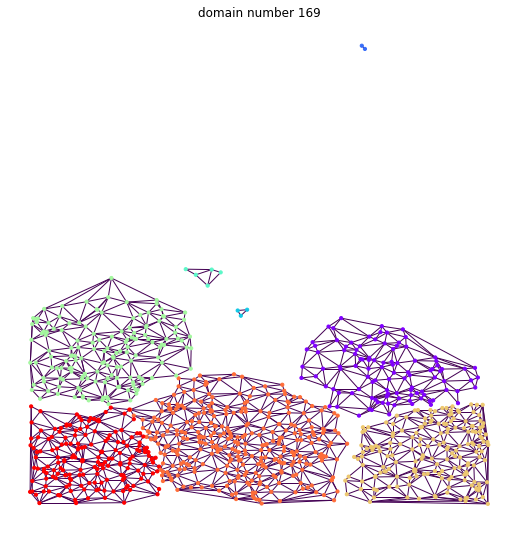

-----------------------------------------------
---------------- domain number 170 ----------------


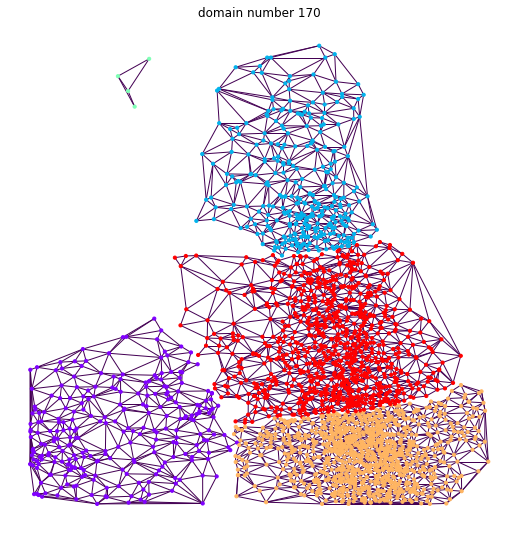

-----------------------------------------------
---------------- domain number 171 ----------------


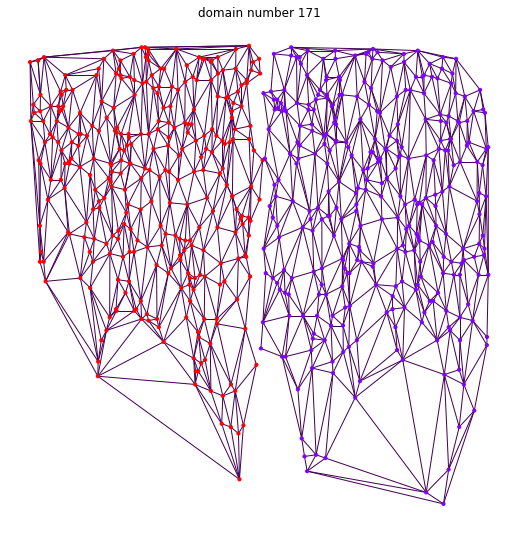

-----------------------------------------------
---------------- domain number 172 ----------------


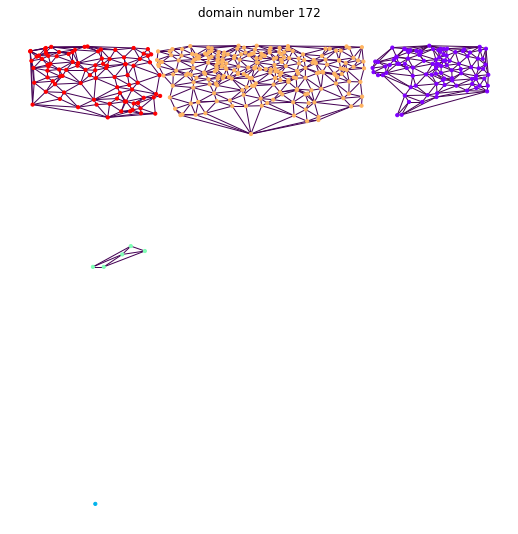

-----------------------------------------------
---------------- domain number 173 ----------------


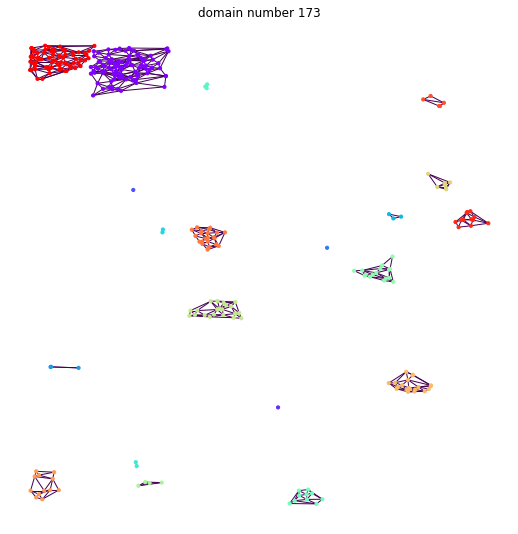

-----------------------------------------------
---------------- domain number 174 ----------------


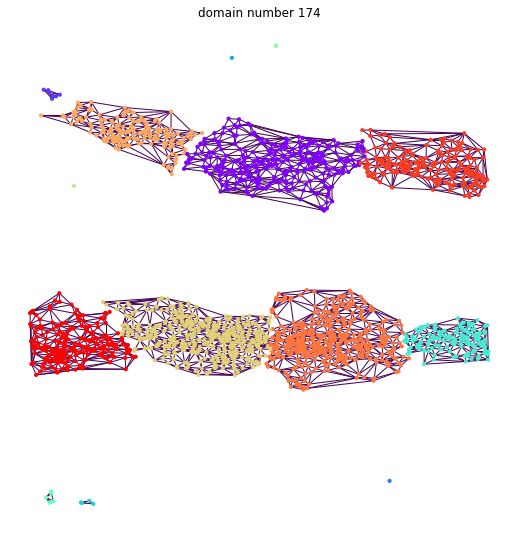

-----------------------------------------------
---------------- domain number 175 ----------------


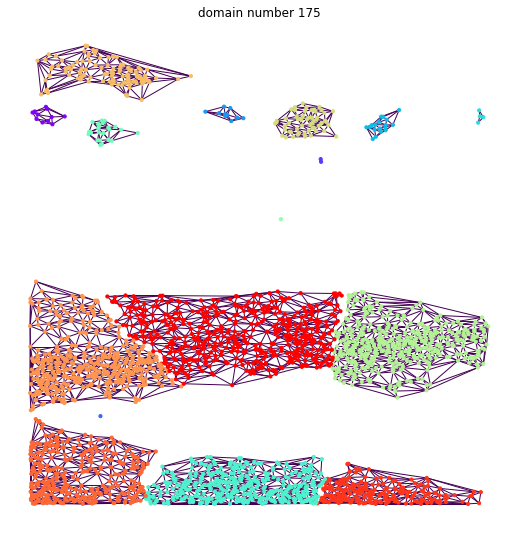

-----------------------------------------------
---------------- domain number 176 ----------------


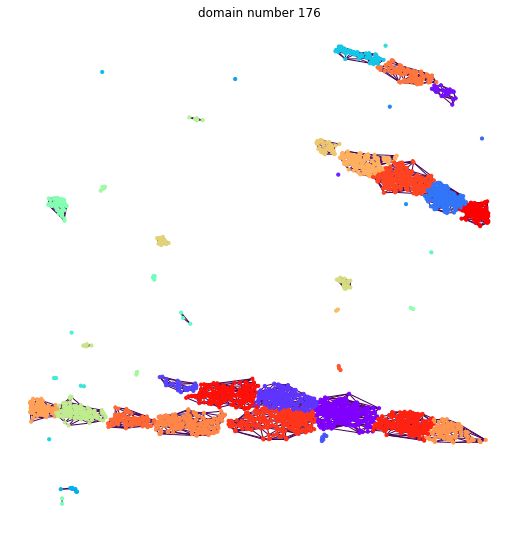

-----------------------------------------------
---------------- domain number 177 ----------------


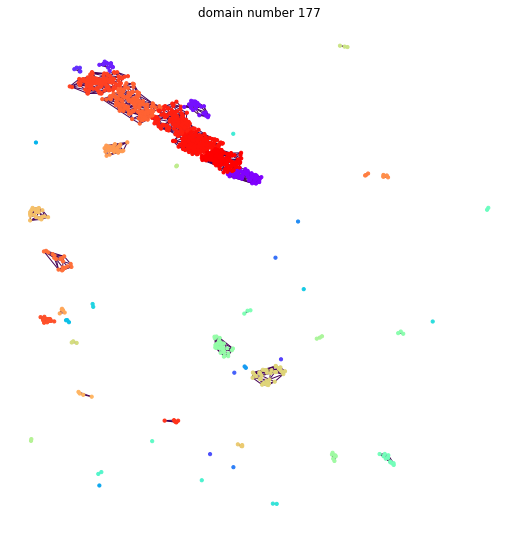

-----------------------------------------------
---------------- domain number 178 ----------------


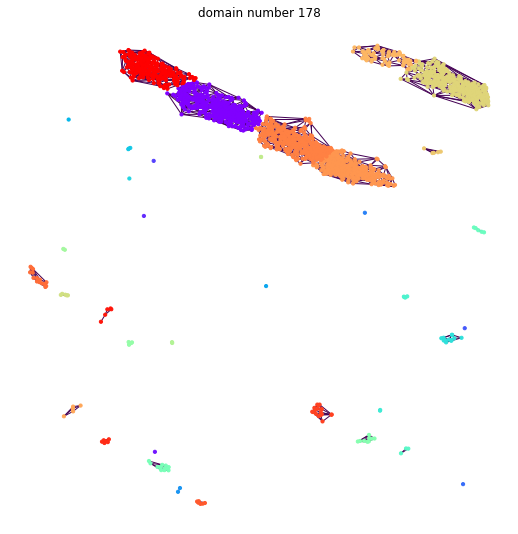

-----------------------------------------------
---------------- domain number 179 ----------------


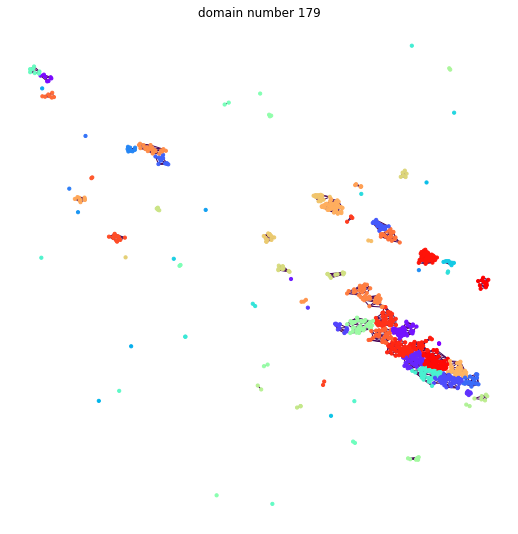

-----------------------------------------------
---------------- domain number 180 ----------------


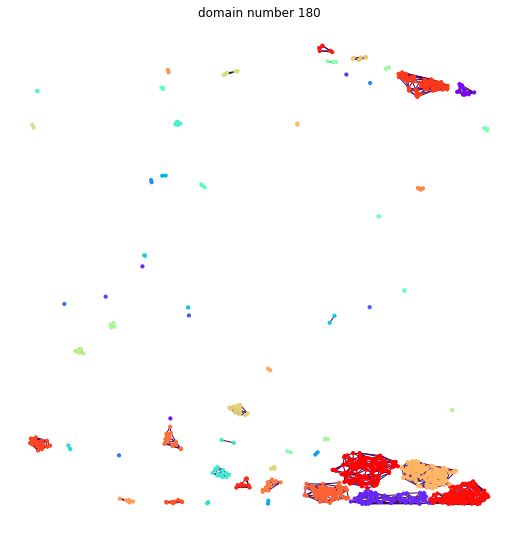

-----------------------------------------------
---------------- domain number 181 ----------------


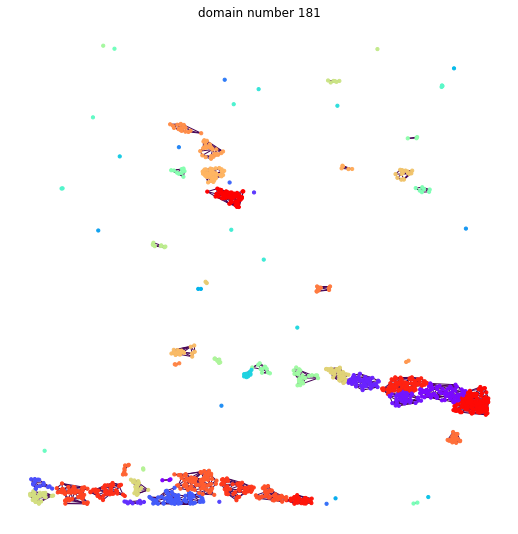

-----------------------------------------------
---------------- domain number 182 ----------------


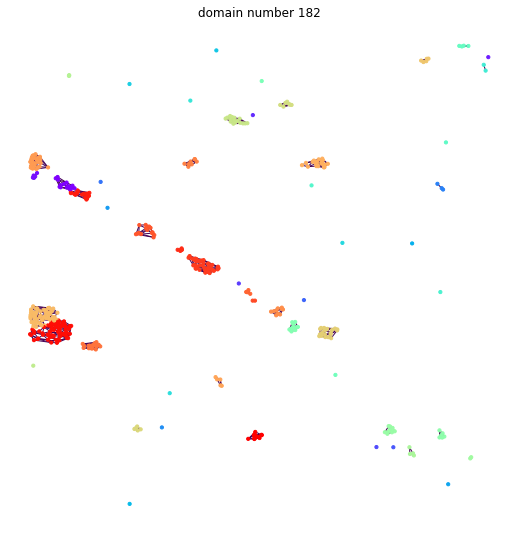

-----------------------------------------------
---------------- domain number 183 ----------------


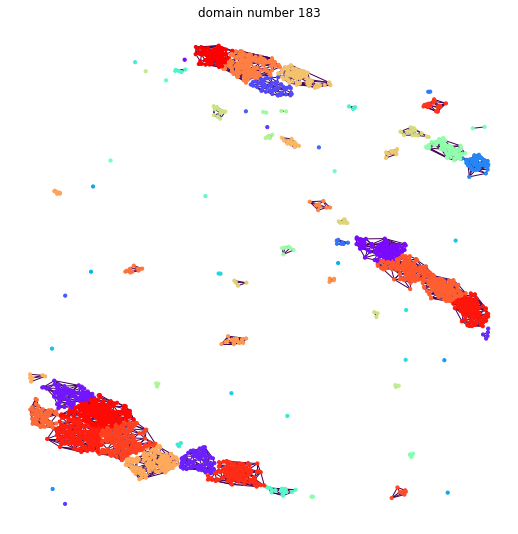

-----------------------------------------------


In [13]:
# cluster in each domain

idx_vec   = []
label_vec = []

for domain_idx in range(n_domains) : 
    print('---------------- domain number ' + str(domain_idx) + ' ----------------')
    idx          = np.where(G_labels == domain_idx)[0]
    if idx.shape[0] > 3 : 
        labels, G, k = cluster_single_scale(P1[idx], Sigma1[idx], list(range(idx.shape[0])), 30, 0)
        plot_clusters_with_graph(G, P1[idx], labels, 'domain number ' + str(domain_idx), 10)
        idx_vec.append(idx)
        label_vec.append(labels)
    print('-------------------------------------------------')

In [17]:
# merge labels of the domains
idx_f       = []
label_f     = []
dummy_label = []

for d in idx_vec:
    for d2 in d: 
        idx_f.append(d2)
            
idx_f = np.array(idx_f)

for i, f in enumerate(label_vec):
    if i == 0:
        maxl = 0
    else:
        maxl = max(label_f) + 1
    for f2 in f:
        dummy_label.append(f2)
        label_f.append(f2 + maxl)
            
label_f = np.array(label_f)
labels1 = label_f
P1      = P1[idx_f]
Sigma1  = Sigma1[idx_f]
n1      = n1[idx_f]

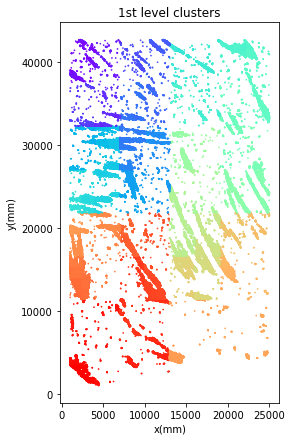

In [18]:
plot_points(P1, labels1, '1st level clusters', 0.5) # not good due to the effect of domain decomposition